___
# Advanced Lane Dectection
# Self-driving Car Nanodegree - Project 4

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline


## Step 1: Distortion Correction
### 1.1 Camera Calibration

camera_cal/calibration10.jpg


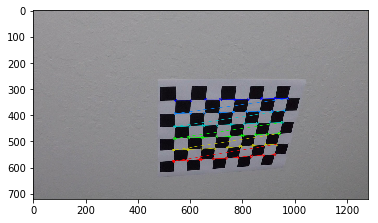

camera_cal/calibration11.jpg


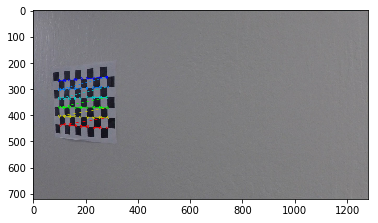

camera_cal/calibration12.jpg


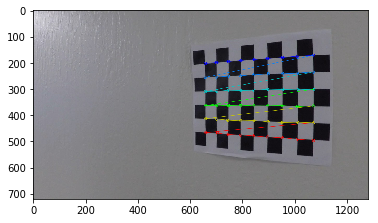

camera_cal/calibration13.jpg


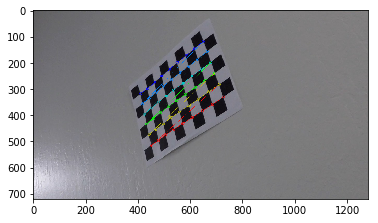

camera_cal/calibration14.jpg


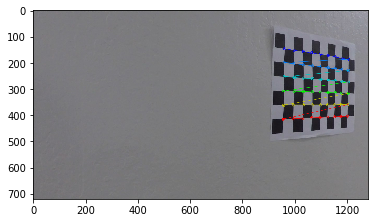

camera_cal/calibration15.jpg


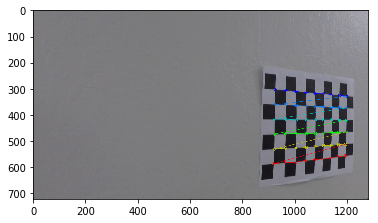

camera_cal/calibration16.jpg


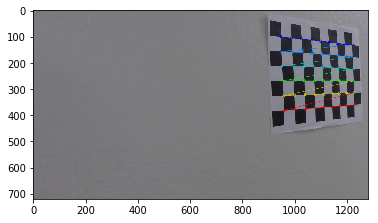

camera_cal/calibration17.jpg


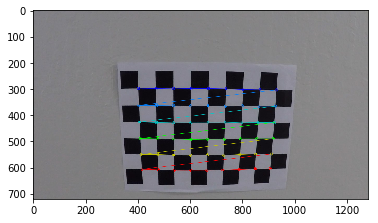

camera_cal/calibration18.jpg


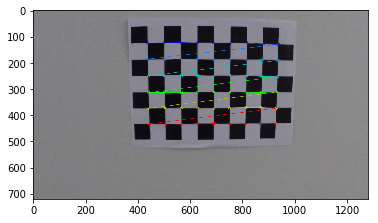

camera_cal/calibration19.jpg


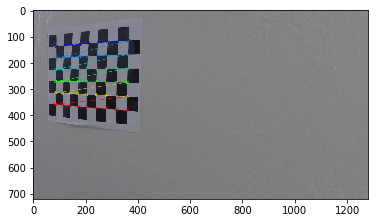

camera_cal/calibration2.jpg


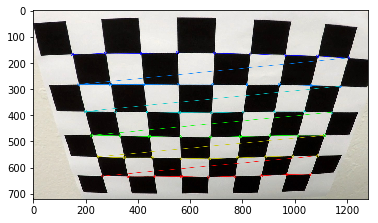

camera_cal/calibration20.jpg


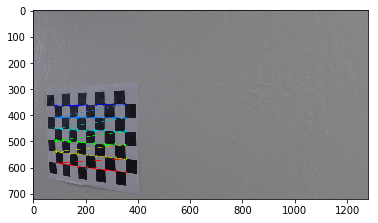

camera_cal/calibration3.jpg


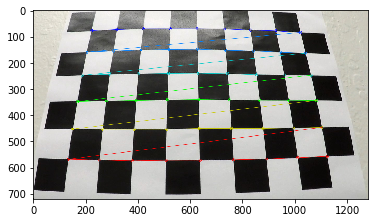

camera_cal/calibration6.jpg


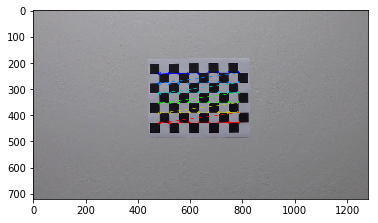

camera_cal/calibration7.jpg


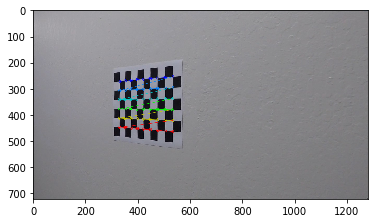

camera_cal/calibration8.jpg


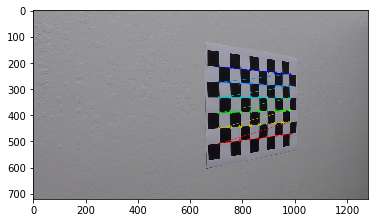

camera_cal/calibration9.jpg


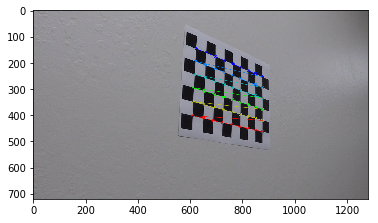

There are  17 caliberation images.


In [2]:
# Arrays to store object points and image points from all the images
objpoints = [] # 3D points in real world space
imgpoints = [] # 2D points in image plane
# prepare object points
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2) # x, y coordinates

# Read caliberation images as a list
image_names = glob.glob('camera_cal/cal*.jpg')
image_count = 0

#use cv2.findChessboardCorners to find image point, preparing for finding camera matrix, ditortion matrix
for image_name in image_names:
    image = mpimg.imread(image_name)
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    if ret == True:
        print(image_name)
        imgpoints.append(corners)
        objpoints.append(objp)
        #draw and display the corners
        image = cv2.drawChessboardCorners(image, (9, 6), corners, ret)
        plot = plt.imshow(image)
        plt.show()
        image_count += 1
print("There are ", image_count, "caliberation images.")


In [3]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
def undistort_image(image, mtx, dist):
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    return undist

** Example of distorted image and undistroted image **

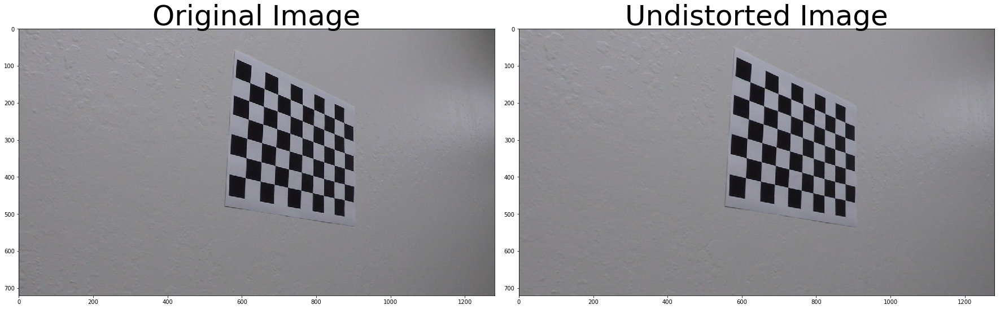

In [4]:
random_nb = np.random.choice(17,1)
image_path = 'camera_cal/calibration'+str(random_nb[0])+'.jpg'
distorted_image = mpimg.imread(image_path)
undistorted_image = undistort_image(distorted_image, mtx, dist)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(distorted_image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted_image)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

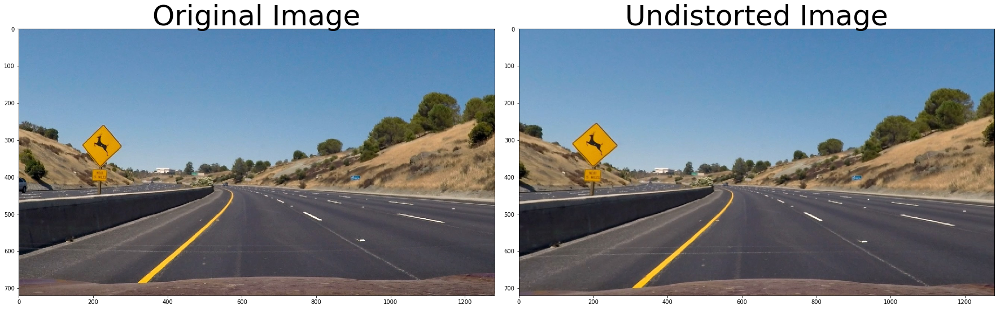

In [5]:
image_path = 'test_images/test2.jpg'
distorted_image = mpimg.imread(image_path)
undistorted_image = undistort_image(distorted_image, mtx, dist)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(distorted_image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted_image)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

___
## Step 2. Pick Thresh
** Helper functions **

In [6]:

def abs_sobel_thresh(img, orient='x', abs_thresh = (0, 255)):
    
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
        
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= abs_thresh[0]) & (scaled_sobel <= abs_thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    binary_output = sxbinary # Remove this line
    return binary_output

def mag_thresh(img, sobel_kernel=3, mag_threshhold=(0, 255)):
    
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    # 3) Calculate the magnitude 
    abs_sobel = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = (abs_sobel * 255 / np.max(abs_sobel)).astype(np.uint8)
    # 5) Create a binary mask where mag thresholds are met
    sobinary = np.zeros_like(scaled_sobel)
    sobinary[(scaled_sobel >= mag_threshhold[0]) & (scaled_sobel <= mag_threshhold[1])] = 1
    # 6) Return this mask as your binary_output image
    binary_output = sobinary # Remove this line
    return binary_output

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    absgraddir = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # 6) Return this mask as your binary_output image
     # Remove this line
    return binary_output



def hls_select(img, channel = 'h', thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls_img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Apply a threshold to the H or L or S channel
    if channel == 'h':
        channel = hls_img[:,:,0]
    elif channel == 'l':
        channel = hls_img[:,:,1]
    else:
        channel = hls_img[:,:,2]
        
    binary_output = np.zeros_like(channel)
    binary_output[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return binary_output



In [7]:
# Load test images
test_image_names = glob.glob('test_images/test*.jpg')
test_image_names.append('test_images/straight_lines1.jpg')
test_image_names.append('test_images/straight_lines2.jpg' )
corrected_images = []
for test_image_name in test_image_names:
    image = mpimg.imread(test_image_name)
    undistort_image = cv2.undistort(image, mtx, dist, None, mtx)
    corrected_images.append(undistort_image.copy())

In [8]:
#define a plot helper function
def plot_helper(original_image, threshed_image):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(11, 5))
    f.tight_layout()
    ax1.imshow(original_image)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(threshed_image, cmap='gray')
    ax2.set_title('threshed_image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

### 1.Sobel X and Y thresh picking

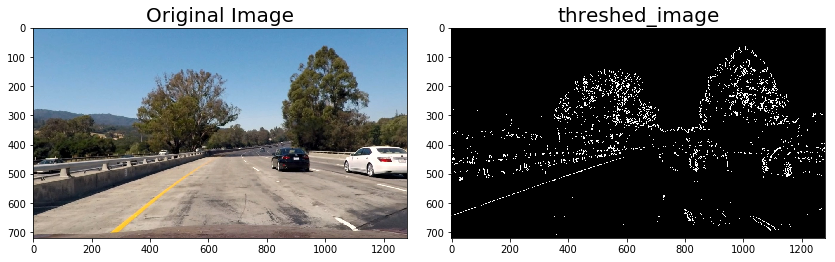

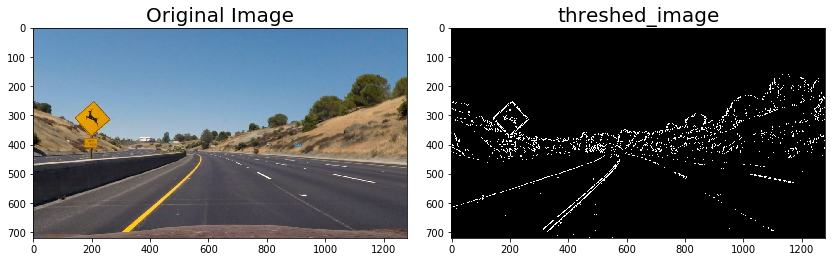

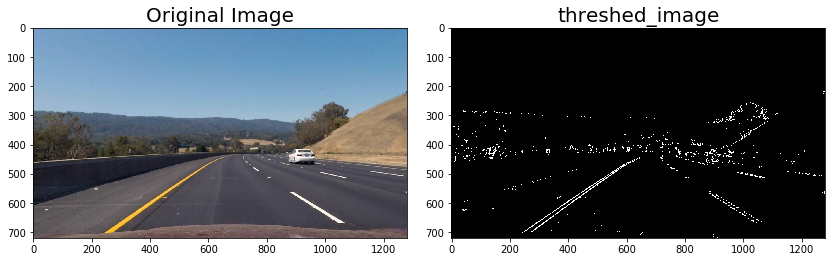

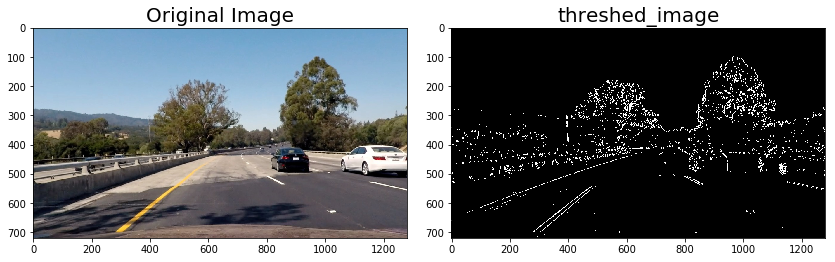

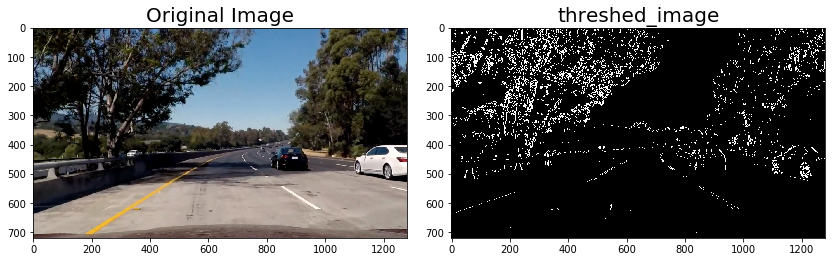

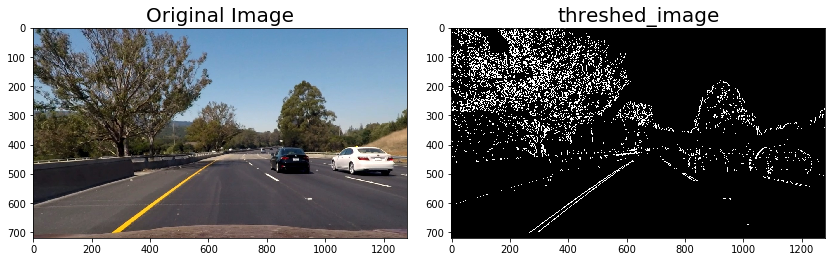

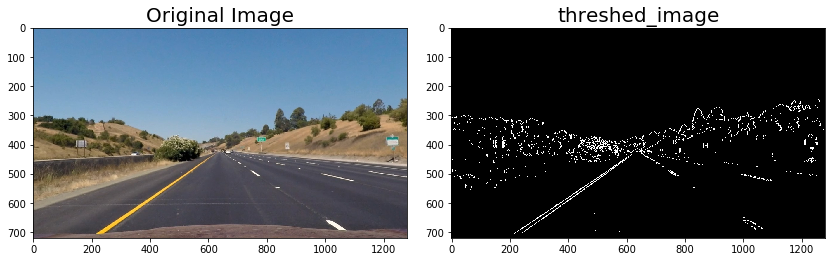

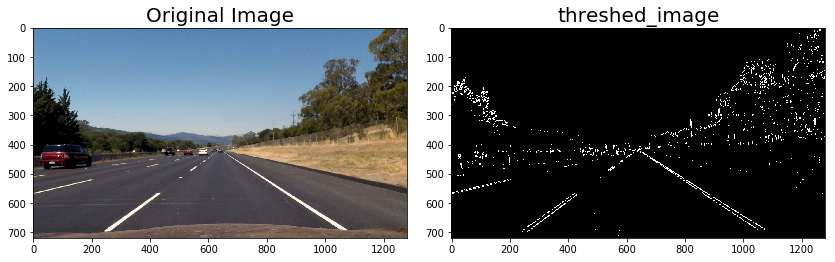

In [9]:
def sobelx_thresh(images, abs_thresh = (50, 100)):
    images_count = len(images)
    count = 0
    for image in images:
        sobelx_binary = abs_sobel_thresh(image, orient='x', abs_thresh=abs_thresh)
        plot_helper(image, sobelx_binary)
        
sobelx_thresh(corrected_images, abs_thresh = (30, 110))
    

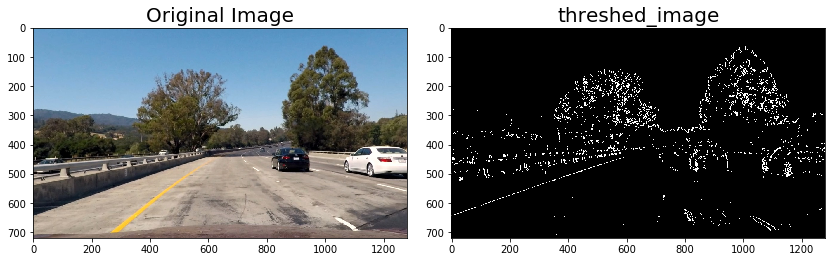

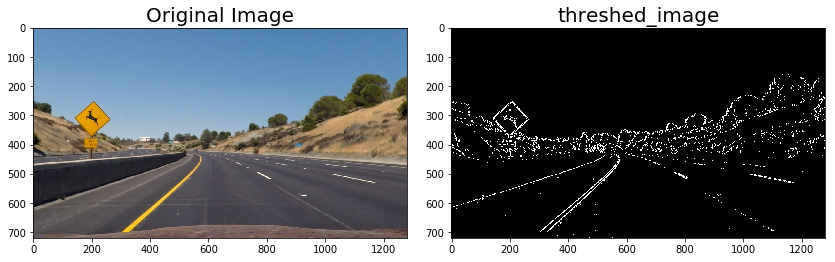

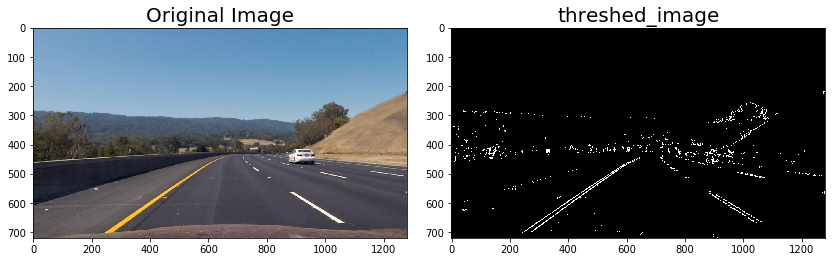

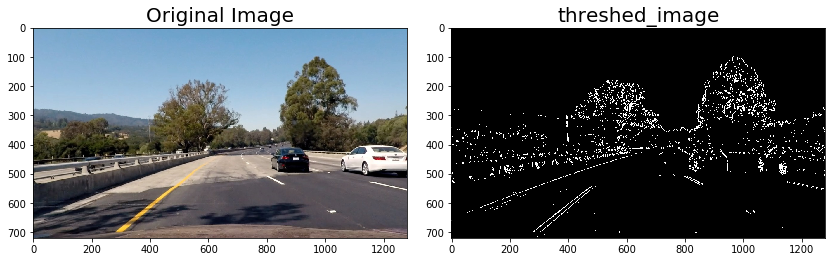

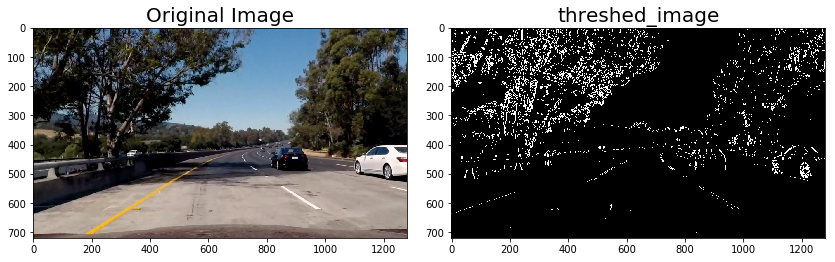

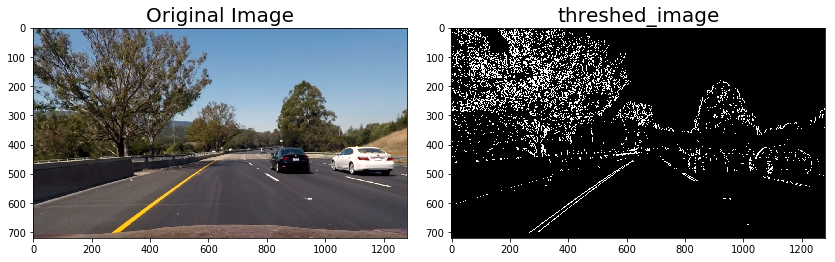

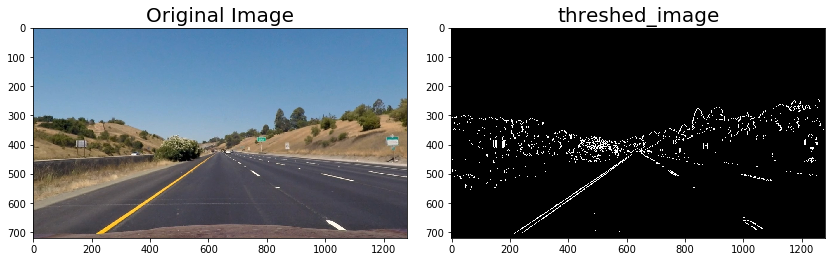

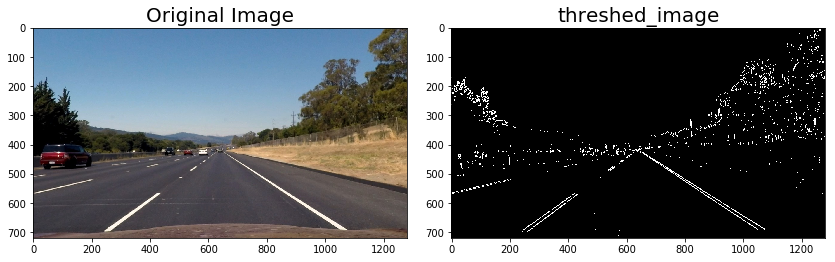

In [10]:
def sobely_thresh(images, abs_thresh = (50, 100)):
    images_count = len(images)
    count = 0
    for image in images:
        sobely_binary = abs_sobel_thresh(image, orient='y', abs_thresh=abs_thresh)
        plot_helper(image, sobely_binary)
sobelx_thresh(corrected_images, abs_thresh = (30, 130))

### 2. Gradient Magnititude thresh picking

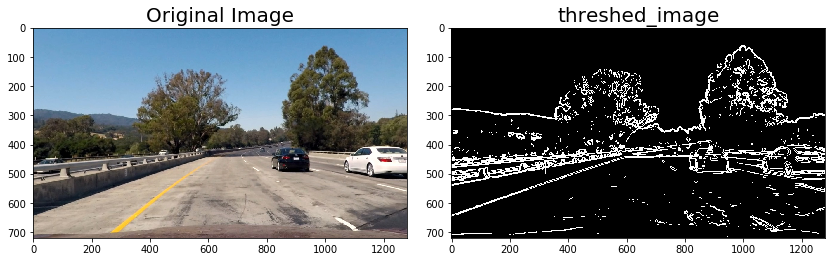

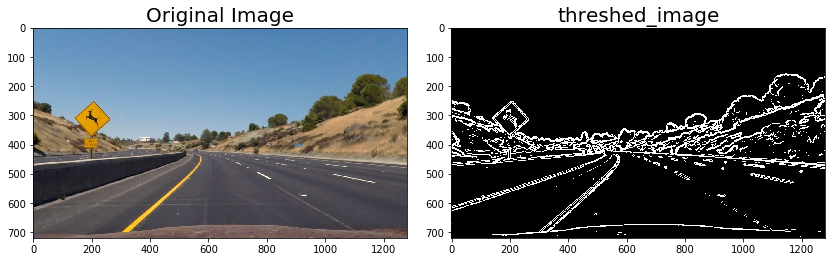

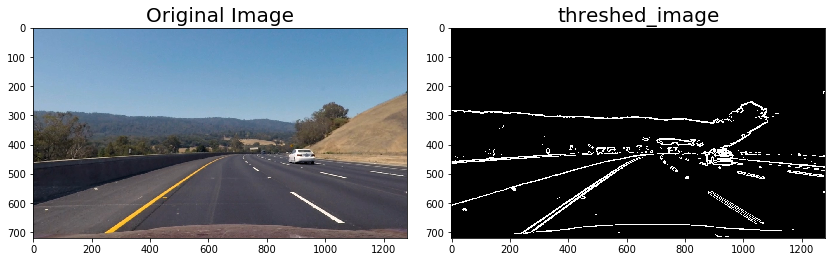

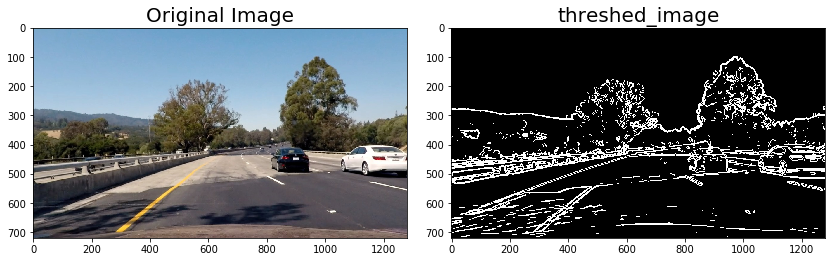

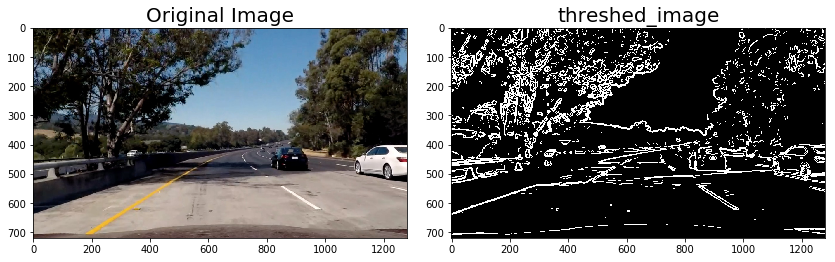

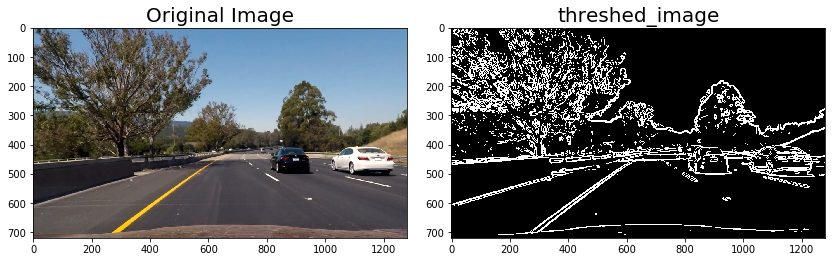

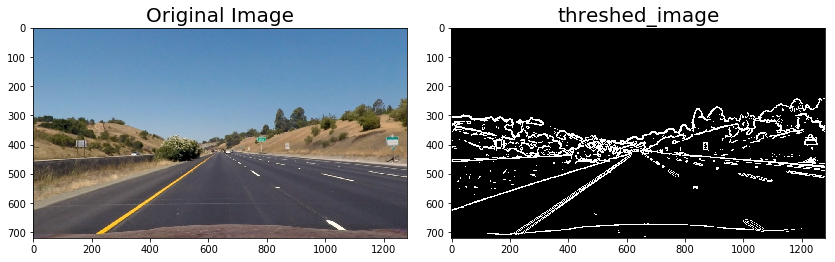

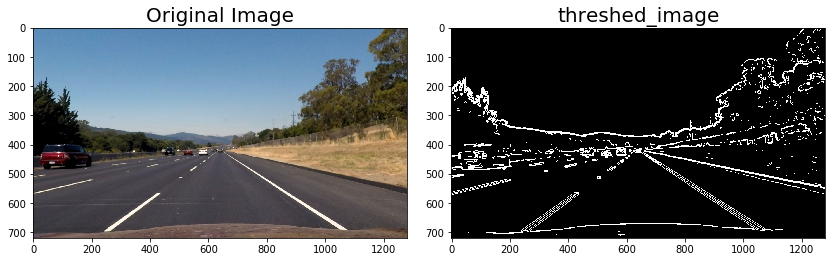

In [11]:
def mag_thresh_picking(images, sobel_kernel = 3, mag_threshhold = (50, 100)):
    images_count = len(images)
    count = 0
    for image in images:
        mag_binary = mag_thresh(image, sobel_kernel= sobel_kernel, mag_threshhold = mag_threshhold)

        plot_helper(image, mag_binary)
mag_thresh_picking(corrected_images, sobel_kernel = 15, mag_threshhold = (40, 150))

### 3. Gradient direction thresh picking

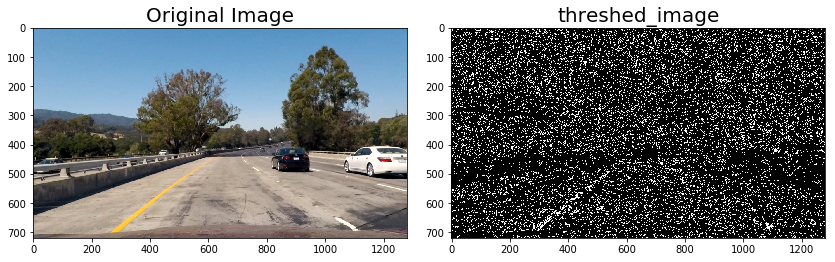

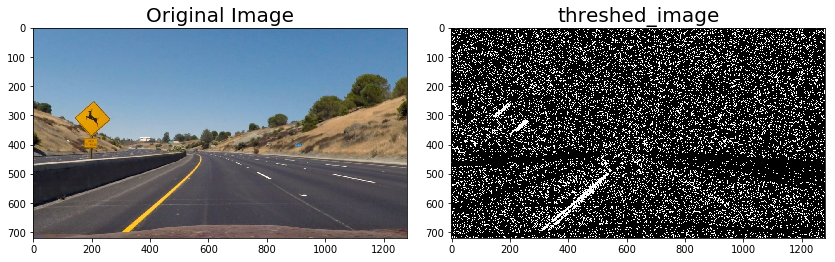

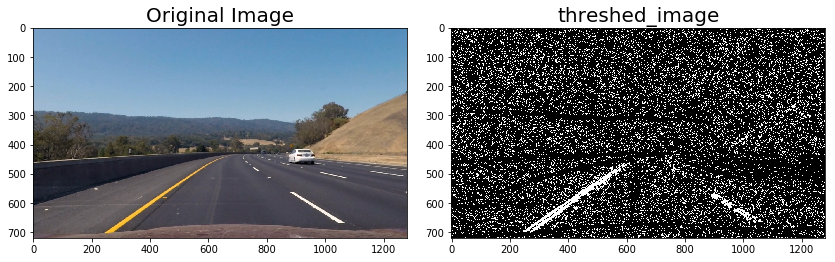

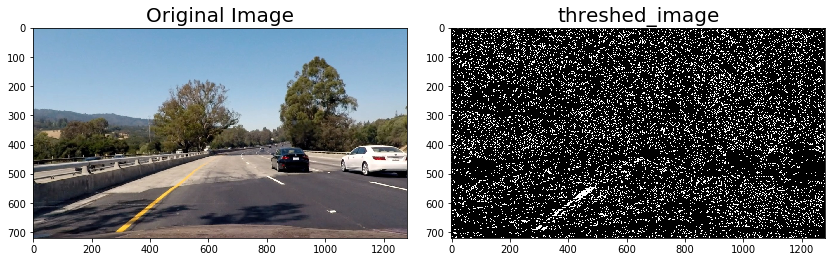

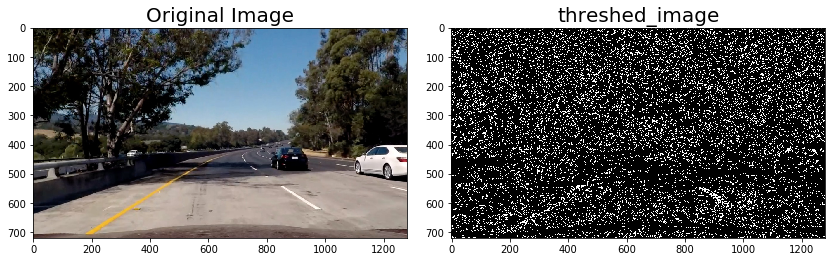

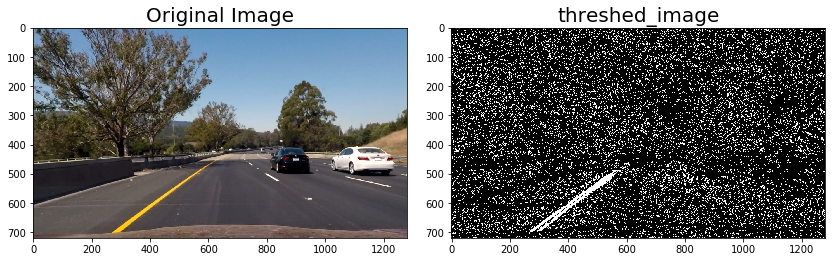

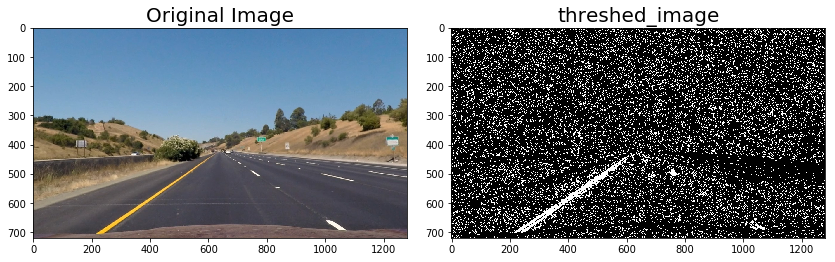

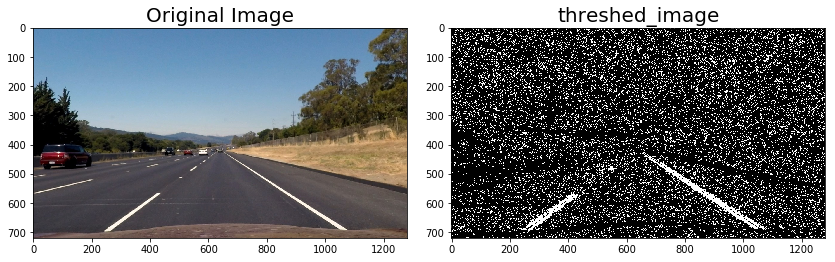

In [12]:
def dir_thresh_picking(images, sobel_kernel = 3, thresh = (0, np.pi/2)):
    images_count = len(images)
    count = 0
    for image in images:
        dir_binary = dir_threshold(image, sobel_kernel=sobel_kernel, thresh=thresh)
        plot_helper(image, dir_binary)
dir_thresh_picking(corrected_images, sobel_kernel = 15, thresh = ( np.pi/4, np.pi/3))

### 4. HLS thresh picking
#### 4.1 H thresh picking

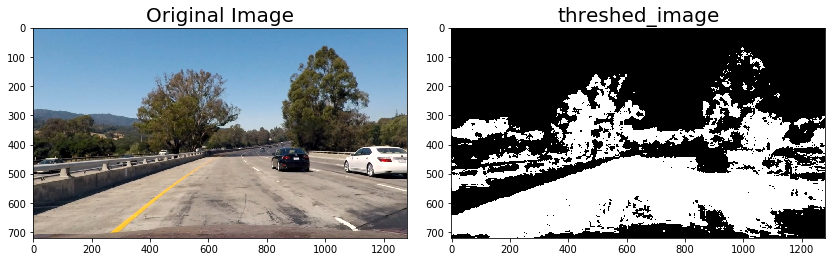

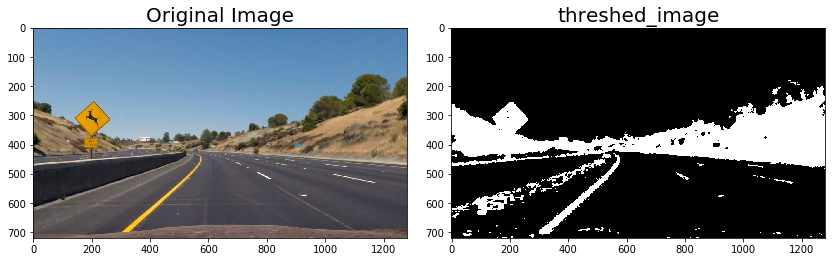

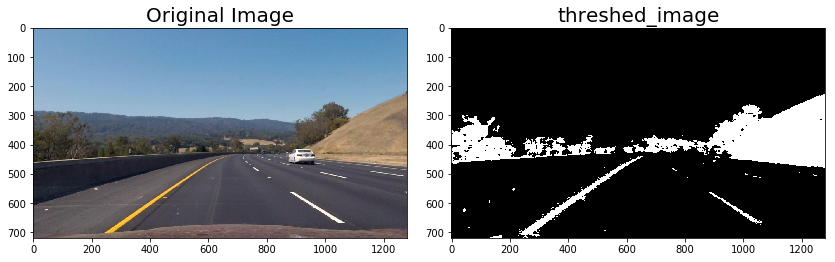

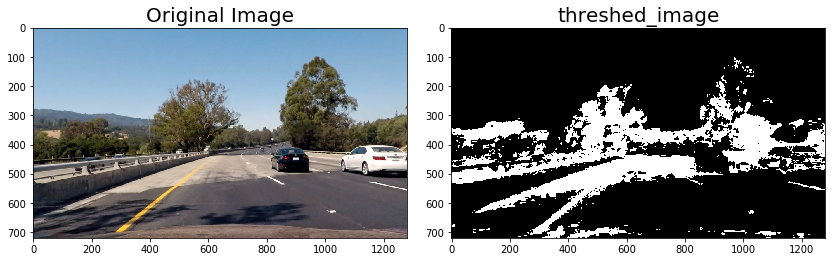

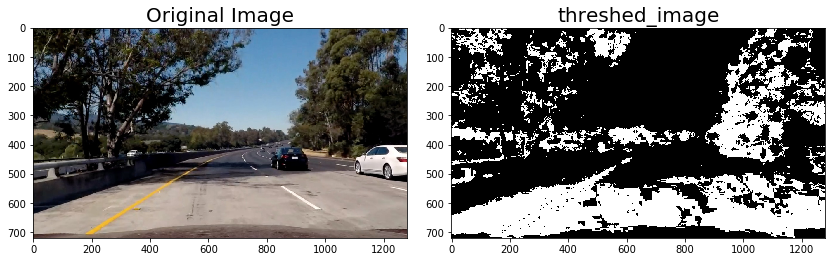

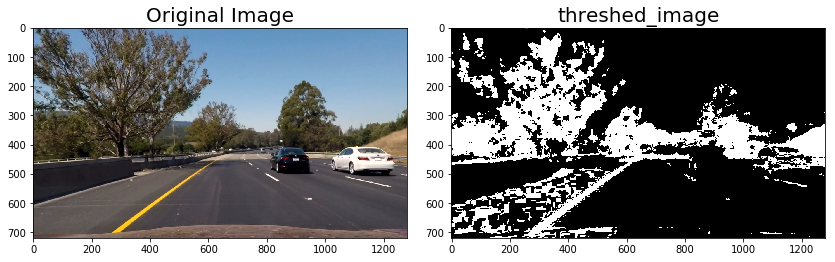

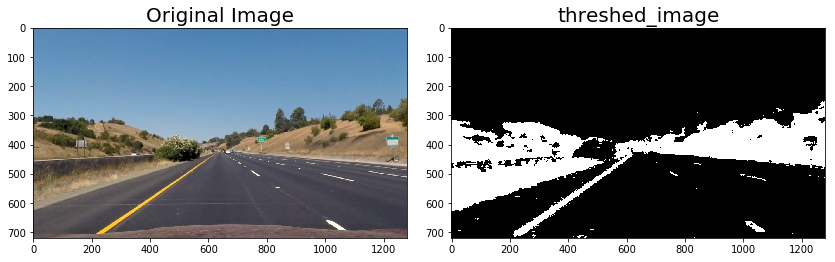

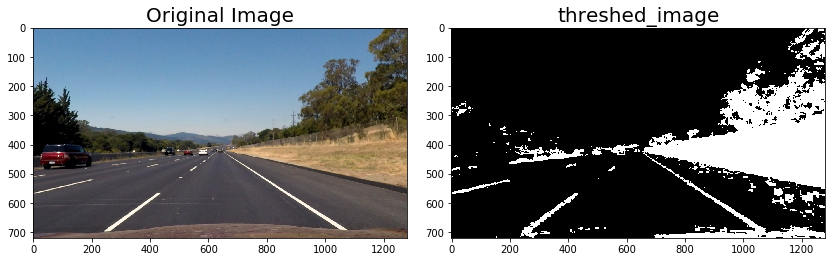

In [13]:
def H_thresh_picking(images, thresh = (0, 255)):
    images_count = len(images)
    count = 0
    for image in images:
        h_binary = hls_select(image, channel = 'h', thresh=thresh)
        plot_helper(image, h_binary)
        
H_thresh_picking(corrected_images, thresh = ( 10, 25))

#### 4.2 L thresh picking

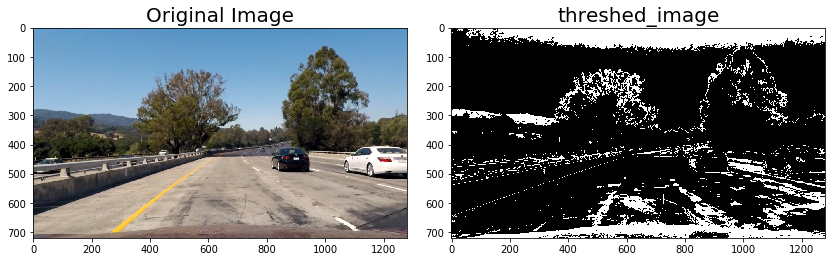

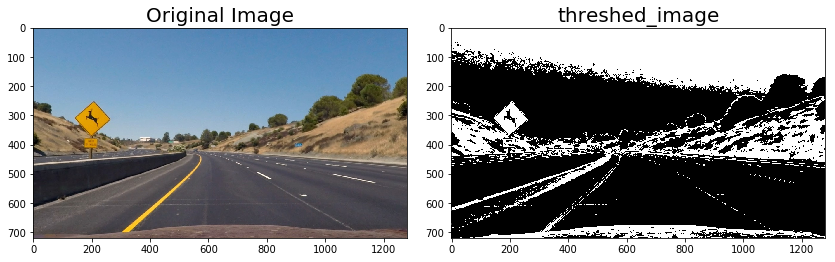

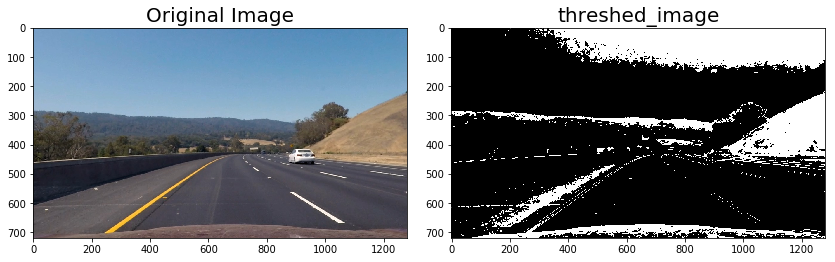

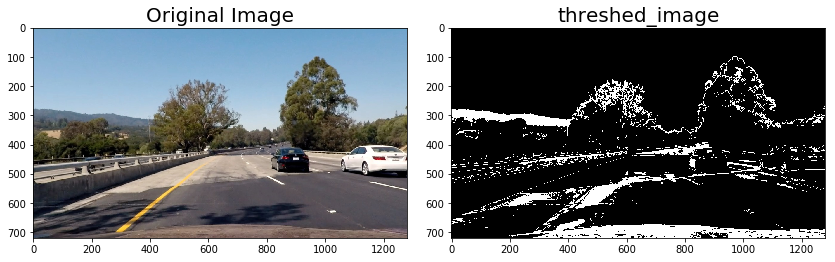

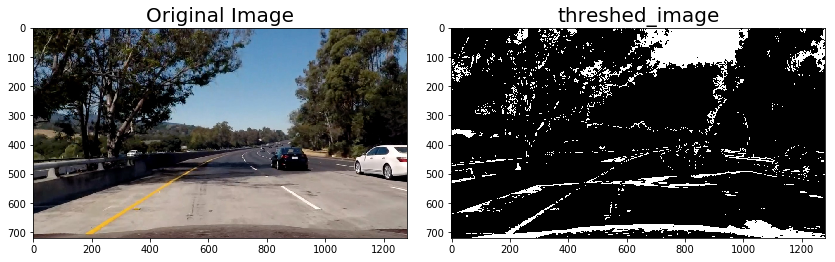

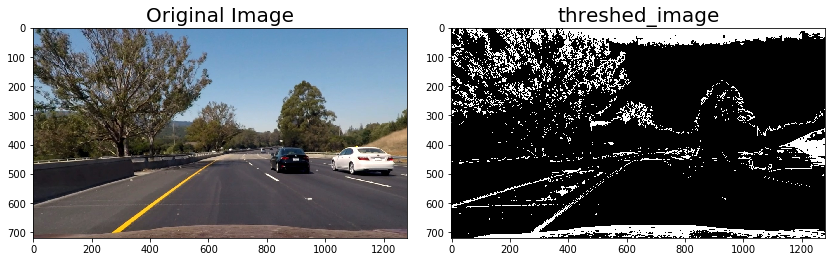

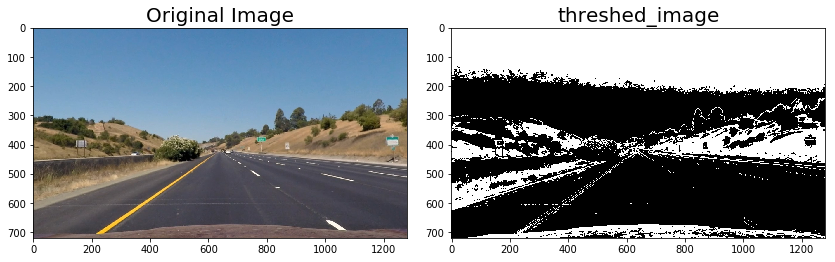

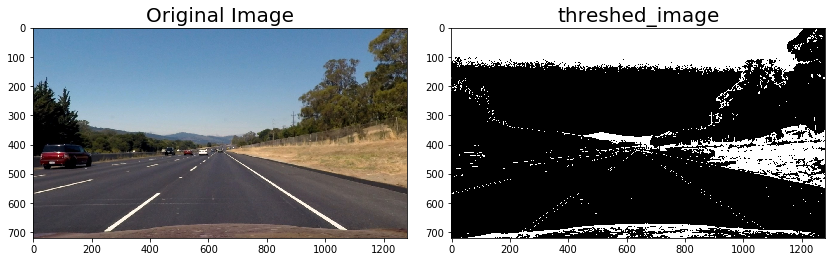

In [14]:
def l_thresh_picking(images, thresh = (0, 255)):
    images_count = len(images)
    count = 0
    for image in images:
        l_binary = hls_select(image, channel = 'l', thresh=thresh)
        plot_helper(image, l_binary)
        
l_thresh_picking(corrected_images, thresh = ( 100, 150))

#### 4.3 S thresh picking

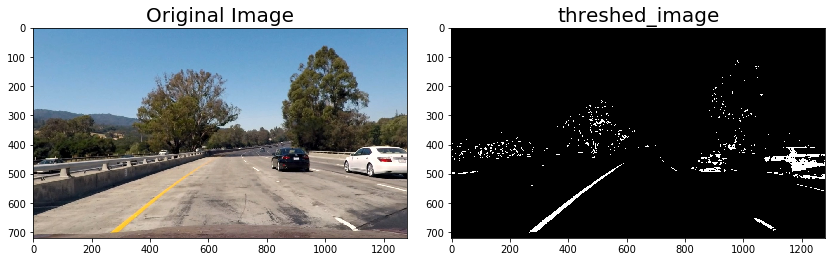

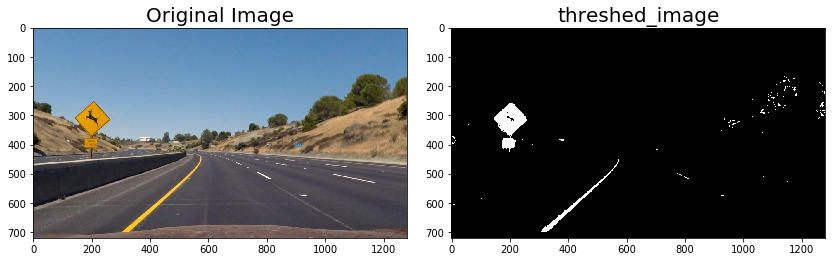

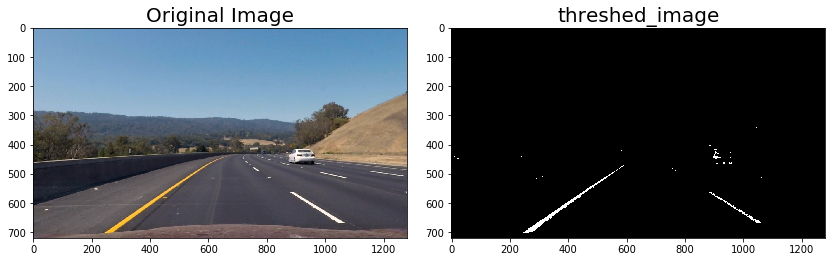

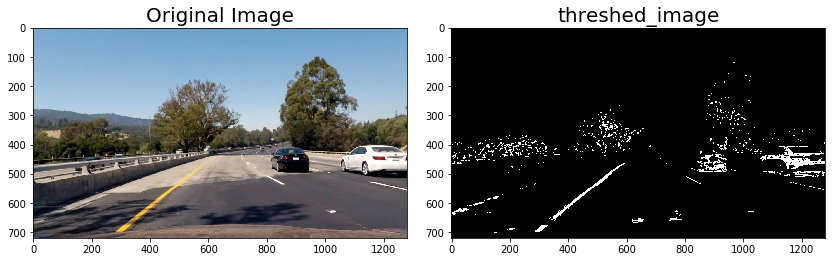

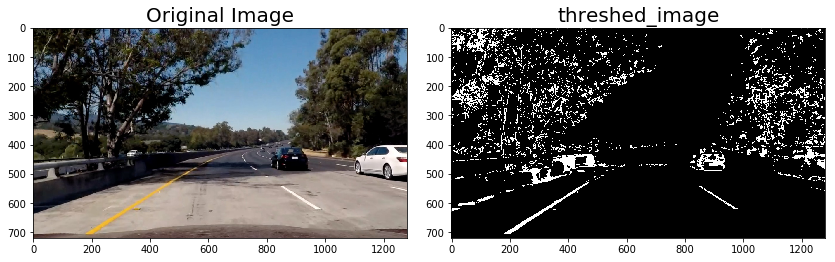

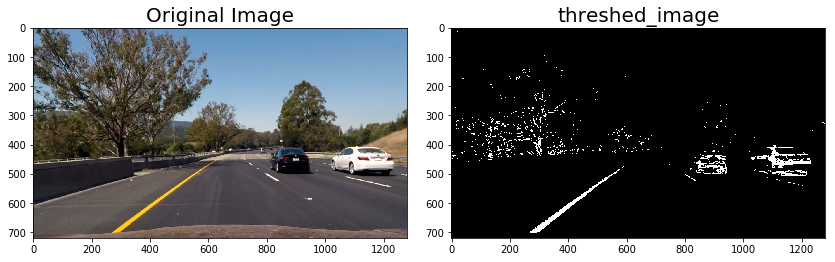

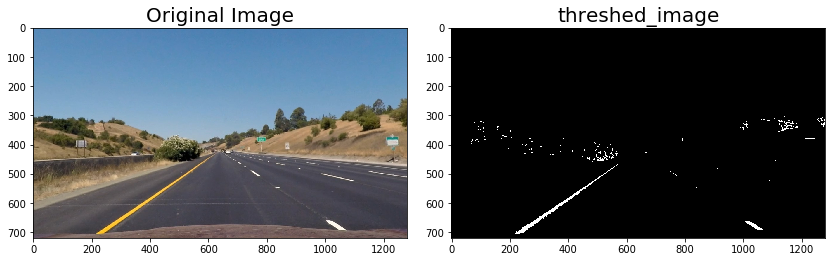

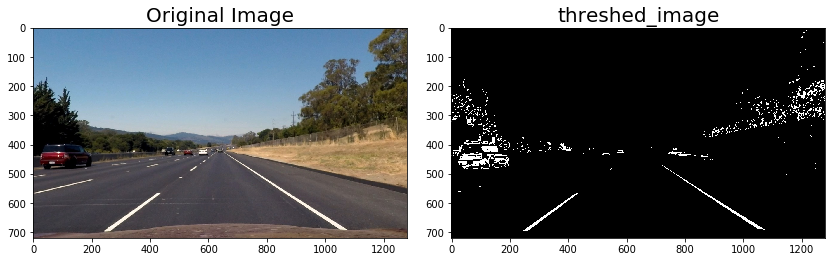

In [15]:
def S_thresh_picking(images, thresh = (0, 255)):
    images_count = len(images)
    count = 0
    for image in images:
        s_binary = hls_select(image, channel = 's', thresh=thresh)
        plot_helper(image, s_binary)
        
S_thresh_picking(corrected_images, thresh = ( 150, 255))

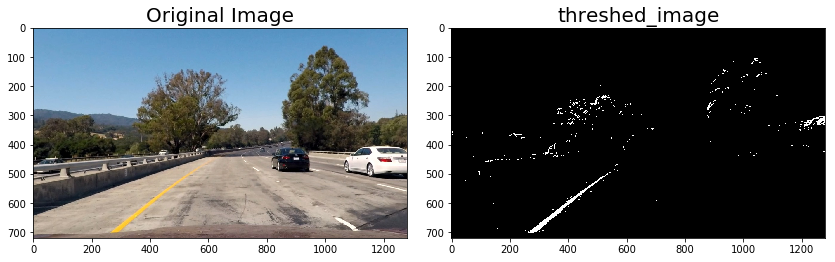

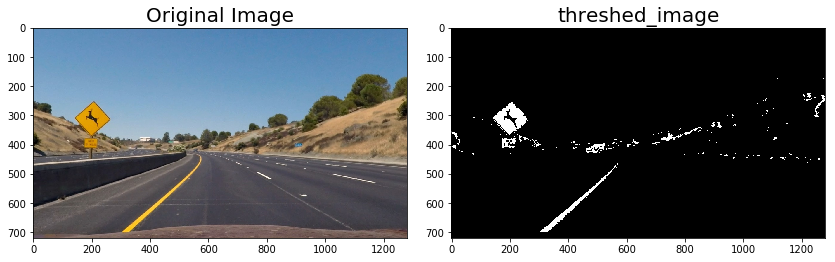

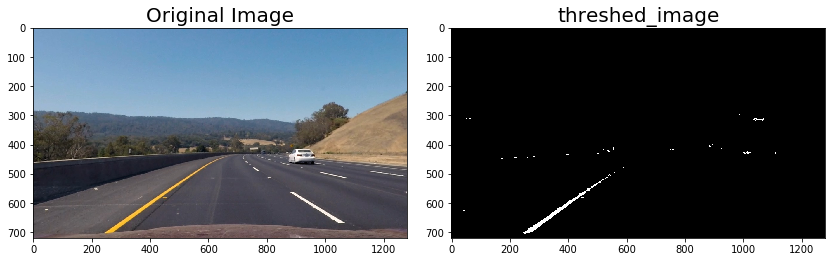

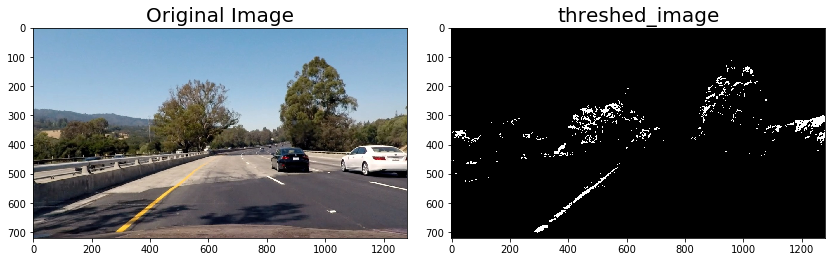

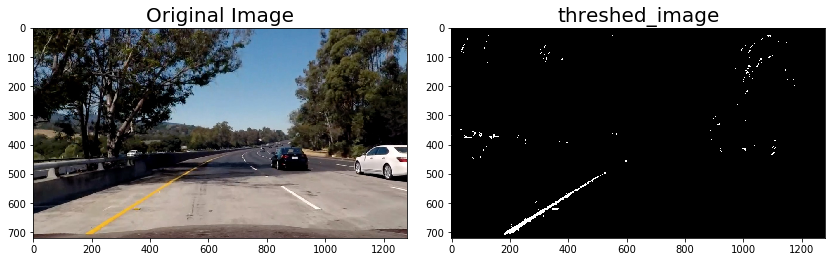

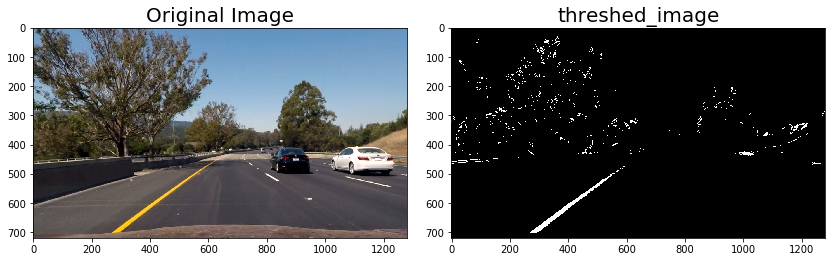

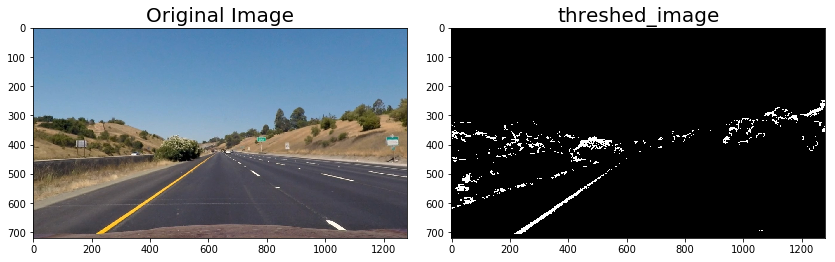

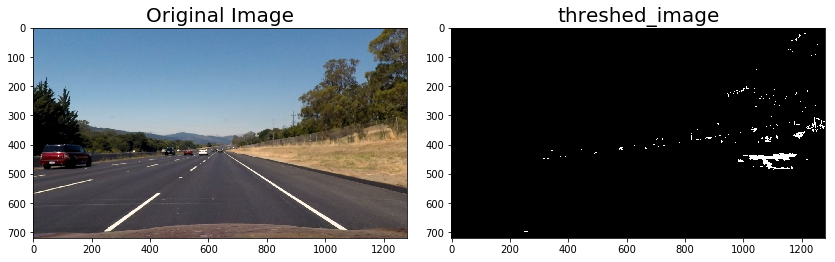

In [16]:
def yellow_picking(image):
    hsv_img = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    lowerb = np.array([20, 40, 100], dtype=np.uint8)
    upperb = np.array([30, 255, 255], dtype=np.uint8)

    mask = cv2.inRange(hsv_img, lowerb, upperb)
    mask[mask==255]=1
    return mask



def hsv_yellow_picking(images):
    images_count = len(images)
    count = 0
    for image in images:
        s_binary = yellow_picking(image)
        plot_helper(image, s_binary)
        
hsv_yellow_picking(corrected_images)

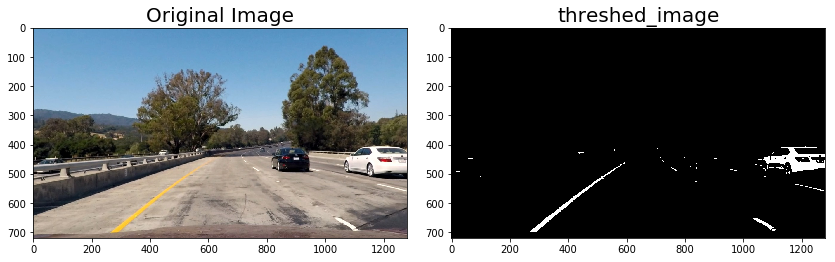

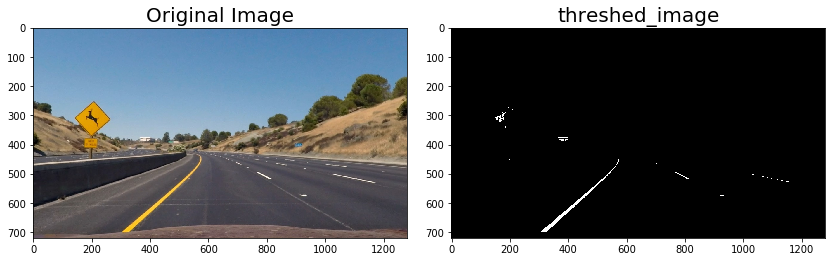

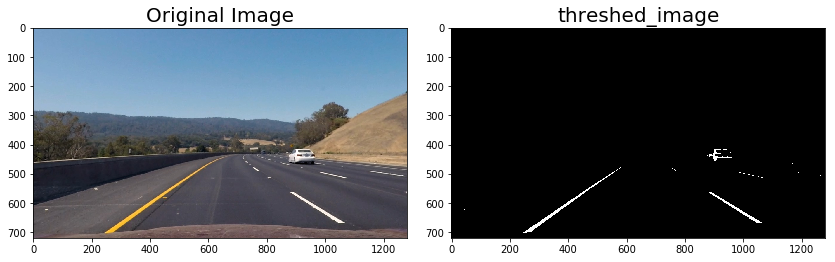

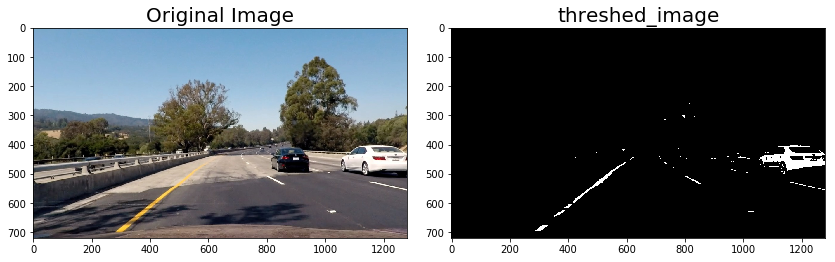

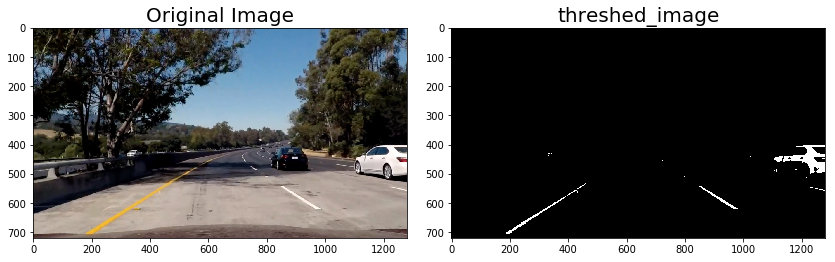

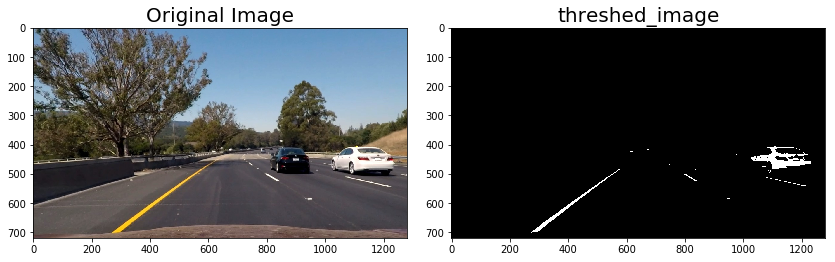

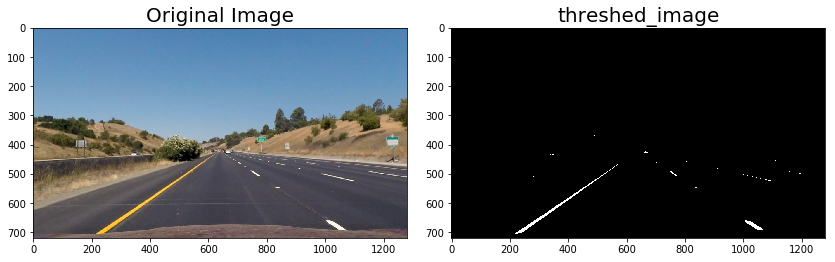

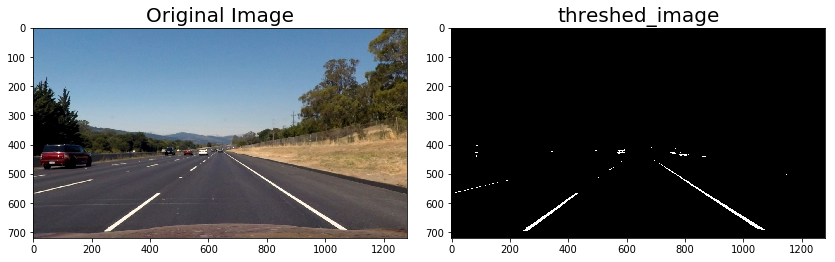

In [17]:

def white_picking(image):
    hsv_img = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    lowerb = np.array([0, 0, 230], dtype=np.uint8)
    upperb = np.array([180, 255, 255], dtype=np.uint8)

    mask = cv2.inRange(hsv_img, lowerb, upperb)
    mask[mask==255]=1
    return mask

def hsv_white_picking(images):
    images_count = len(images)
    count = 0
    for image in images:
        w_binary = white_picking(image)
        plot_helper(image, w_binary)
        
hsv_white_picking(corrected_images)

---
## Step 3 Combine binary pictures

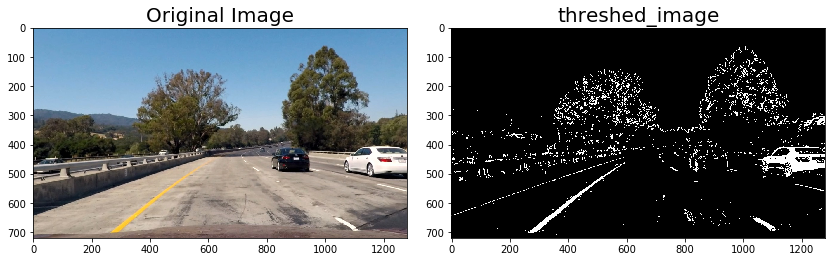

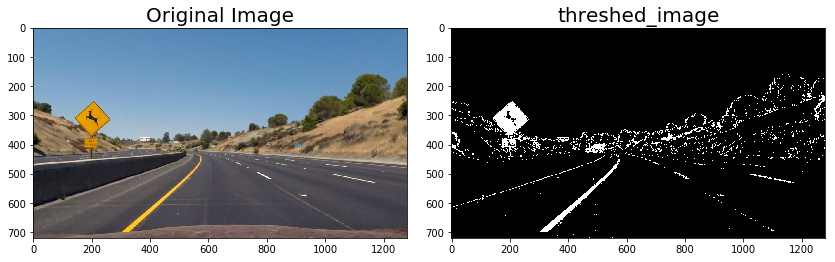

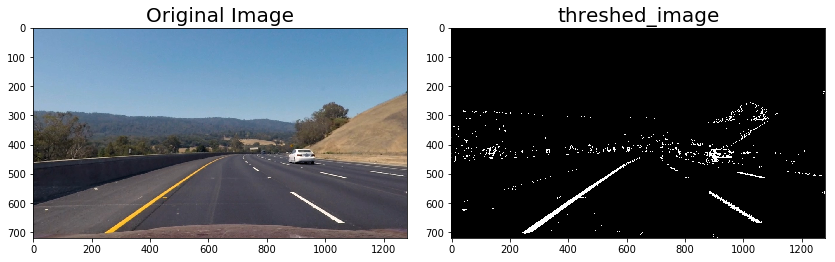

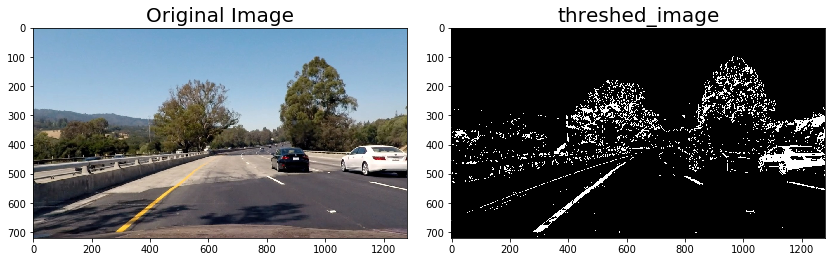

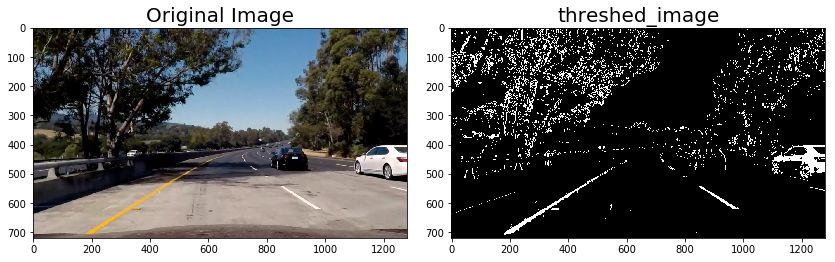

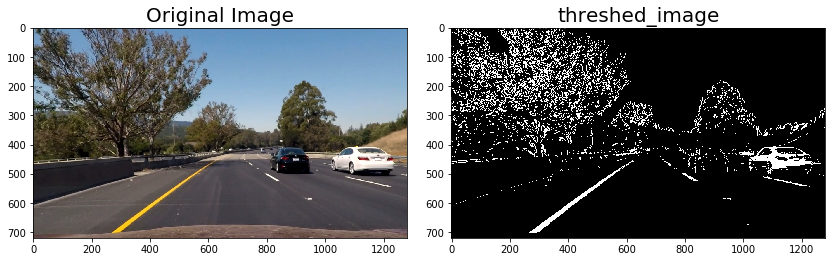

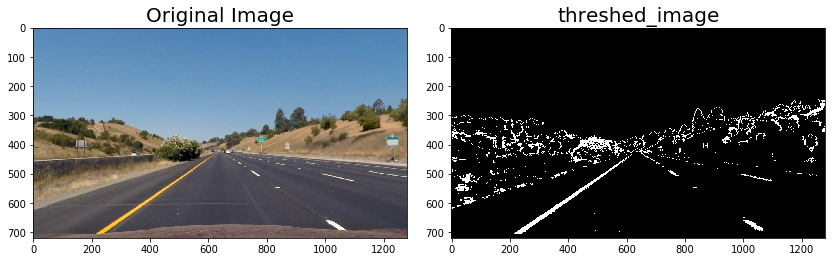

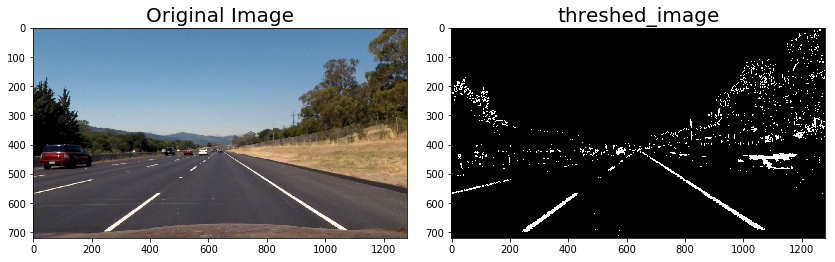

In [18]:
for image in corrected_images:
    sobelx_binary = abs_sobel_thresh(image, orient='x', abs_thresh=(30, 110))
    sobely_binary = abs_sobel_thresh(image, orient='y', abs_thresh=(80, 130))
    mag_binary = mag_thresh(image, sobel_kernel= 15, mag_threshhold = (10, 150))
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(np.pi/4.5, np.pi/3))
    h_binary = hls_select(image, channel = 'h', thresh=(0, 35))
    l_binary = hls_select(image, channel = 'l', thresh=( 135, 155))
    s_binary = hls_select(image, channel = 's', thresh=( 150, 255))
    yellow_binary = yellow_picking(image)
    white_binary = white_picking(image)
    
    combined_binary = np.zeros_like(s_binary)
    combined_binary[(yellow_binary == 1) | (white_binary ==1) | (sobelx_binary== 1)] =1
    plot_helper(image, combined_binary)
    

----
## Step 4 Perspective Transform

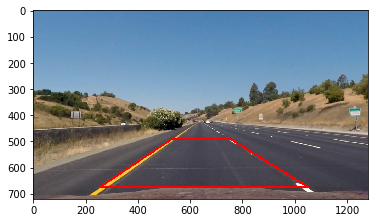

In [19]:
%matplotlib inline
# %matplotlib qt
image = mpimg.imread('test_images/straight_lines1.jpg')
image = cv2.undistort(image, mtx, dist, None, mtx)
width = image.shape[1]
height = image.shape[0]
center_x = int(width/2)
apex_y = 430
offset_top = 14
offset_bottom = 405
bottom_y = 676

# src = np.float32([[center_x -offset_bottom,bottom_y],
#                   [center_x + offset_bottom,bottom_y],
#                   [center_x + offset_top,apex_y],
#                   [center_x - offset_top,apex_y]])
# dst = np.float32([[0,720],
#                   [1280,720],
#                   [1280, 0],
#                   [0,0]])

src = np.float32([[753.5, 490.5],
                  [532.5, 490.5],
                  [256.5, 674.5],
                  [1051.5, 674.5]])


dst = np.float32([[930, 300],
                  [260, 300],
                  [260,700],
                  [930, 700],
                  ])
cv2.polylines(image, np.int32([src]), 1,[255,0,0],thickness = 5)
plt.imshow(image)

#define perspective transform function
def perspective_transform(img, M):
    warped = cv2.warpPerspective(img, M, dsize = (img.shape[1],img.shape[0]), flags = cv2.INTER_LINEAR)
    return warped
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)

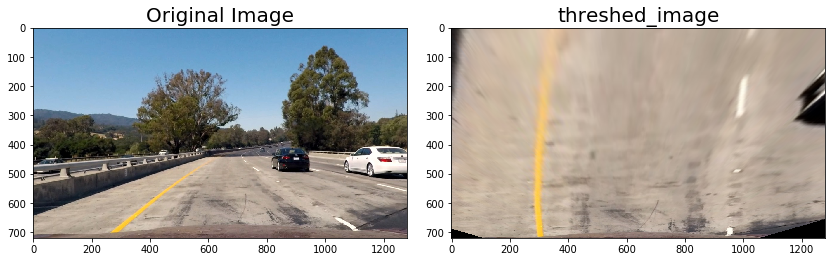

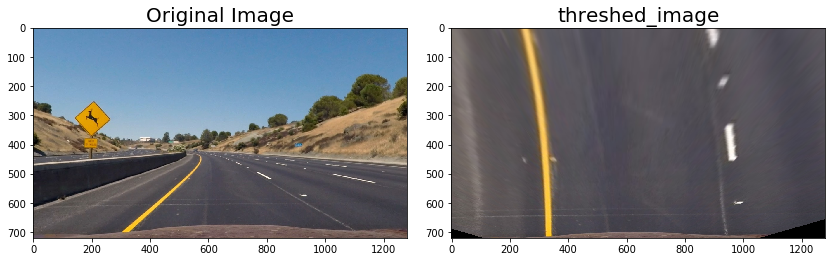

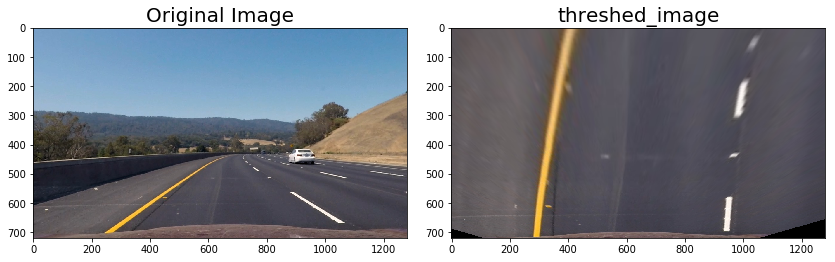

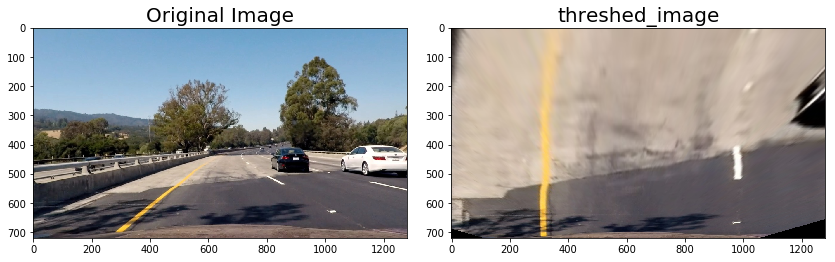

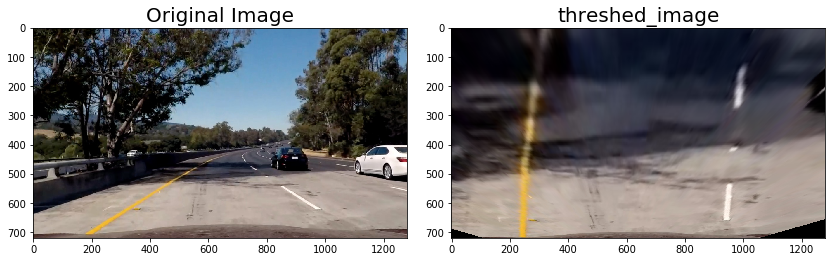

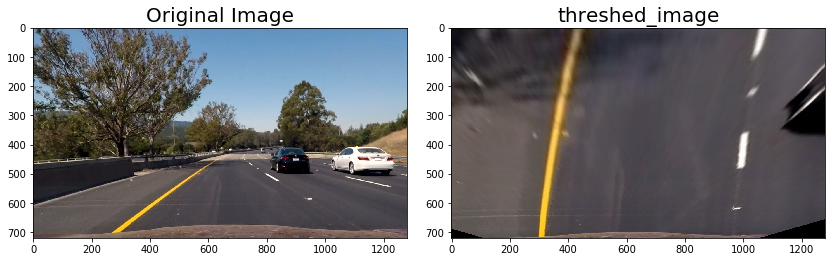

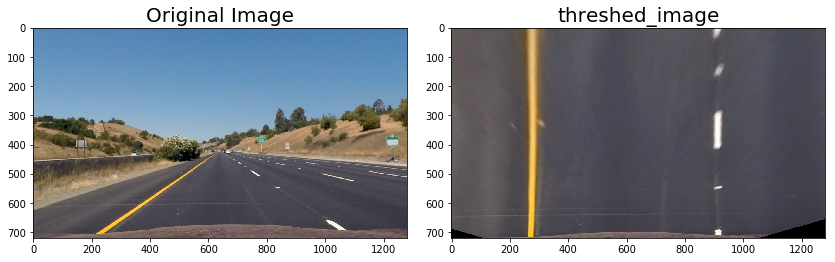

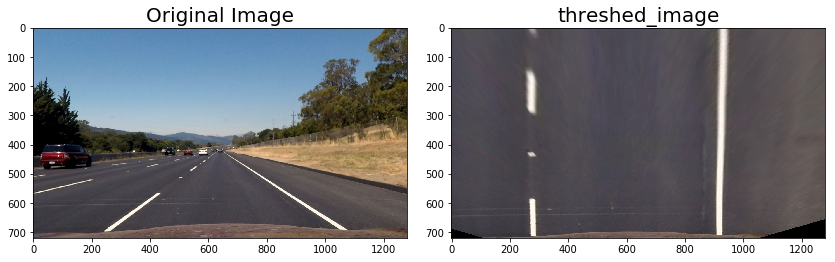

In [20]:
#test on test images
for image in corrected_images:
    warped = perspective_transform(image, M)
    plot_helper(image, warped)

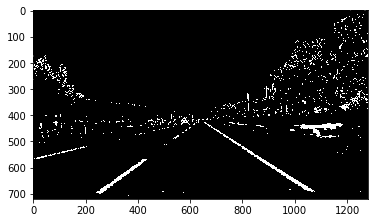

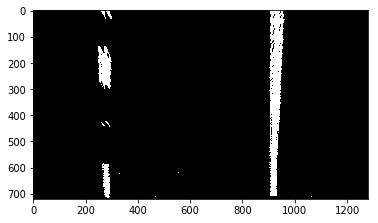

In [21]:
#test on combined binary images
warped = perspective_transform(combined_binary, M)
plot = plt.imshow(combined_binary, cmap = 'gray')
plt.show()
plot = plt.imshow(warped, cmap = 'gray')
plt.show()


----
## Step 5 Finding the Lines
### Implement Sliding Windows and Fit a Polynomial

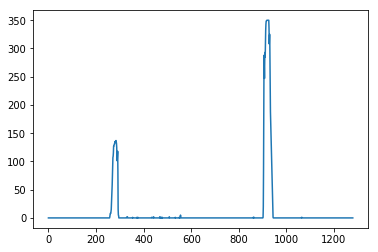

In [22]:
#finding the lines
binary_warped = warped.copy()
# Take a histogram of the bottom half of the image
histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
plt.plot(histogram)

(720, 0)

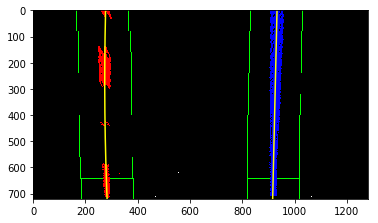

In [23]:
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_warped.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50

# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []
# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)



(720, 0)

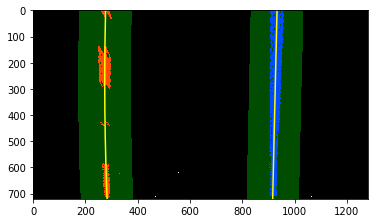

In [24]:
# Create an image to draw on and an image to show the selection window
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
window_img = np.zeros_like(out_img)
# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

___
# Section for define pipeline function and pipeline

In [25]:
#Function for pre-processing images (undistort, producing combined binary image)
def image_preporcessing(image, mtx, dist):
    """
    Function for pre-processing images (undistort, producing combined binary image).
    input: image (processing image)
            mtx (camera conversion matrix)
            dist (camera distortion matrix)
            threshhold has been hard coded in the function
    """
    # Undistort original image
    image = cv2.undistort(image, mtx, dist, None, mtx)
    # Sobel X and Y binary
    sobelx_binary = abs_sobel_thresh(image, orient='x', abs_thresh=(30, 110))
    sobely_binary = abs_sobel_thresh(image, orient='y', abs_thresh=(30, 130))
    # Magnitude binary 
    mag_binary = mag_thresh(image, sobel_kernel= 15, mag_threshhold = (50, 150))
    # Gradient direction binary
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(np.pi/4.5, np.pi/3))
    # HLS Binary
    h_binary = hls_select(image, channel = 'h', thresh=(0, 35))
    l_binary = hls_select(image, channel = 'l', thresh=( 135, 155))
    s_binary = hls_select(image, channel = 's', thresh=( 150, 255))

    # Combine binary
    combined_binary = np.zeros_like(s_binary)
#     combined_binary[( (h_binary == 1) &(s_binary == 1))\
#                     | (((sobelx_binary ==1) | (sobely_binary ==1))& (dir_binary ==1)) ] =1
    yellow_binary = yellow_picking(image)
    white_binary = white_picking(image)
    

    combined_binary[(yellow_binary == 1) | (white_binary ==1) | (sobelx_binary== 1)] =1
    
    

    return combined_binary

In [26]:

#Function for unwarp images and return warp matrix and unwarp matrix (inverse)
def warp(combined_binary, src, dst):
    """
    Function for unwarp images and return warp matrix and unwarp matrix (inverse)
    Input: src (source points: 4 points)
            dst (distination points: 4 points, same sequence as src)
    """
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(combined_binary, M, dsize = \
                                 (combined_binary.shape[1],combined_binary.shape[0]),\
                                 flags = cv2.INTER_LINEAR)
    return warped, M, Minv

In [27]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last 10 iterations
        self.bestx = None
        #polynomial coefficients last 10 iterations
        self.fit = []
        #polynomial coefficients averaged over the last 10 iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        # radius of curvature of the last 10 lines
        self.curvatures = []
        #average radius of curvature of the last 10 lines in meters
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from last 10 line
        self.line_base_pos = [] 
        #distance in meters of vehicle center from last 10 line
        self.line_avg_pos = None
        
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

In [28]:
# Function used to find line related points (used when previous line was not detected) 
def find_LinePoints_slicing_window(binary_warped, nwindows = 9, margin = 100, minpix = 50):
    """
    Function used to find line related points and return searching image (used when previous line was not detected)
    Choose the number of sliding windows 
    # Set the width of the windows +/- margin
    # Set minimum number of pixels found to recenter window"""
    
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Take a histogram of the bottom two windows height of the image
    image_height = binary_warped.shape[0]
    histogram = np.sum(binary_warped[(image_height - 2 * window_height):, :], axis = 0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    return leftx, lefty, rightx, righty
        
    

In [29]:
# Function used to find line related points (used when previous line was detected) 
def find_LinePoints_quick(binary_warped, margin = 100):
    """
    Function used to find line related points (used when previous line was detected)
    """
    # First find nonzero indices
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Pass previous fit to current fit
    left_fit = left_line.current_fit
    right_fit = right_line.current_fit
    # Find point indices
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) &\
                      (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) &\
                       (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    return leftx, lefty, rightx, righty
    
    

In [30]:
# Function to fit lines and return left_fit and right_fit
def fit_lines(leftx, lefty, rightx, righty):
    """
    Function to fit lines and return left_fit and right_fit
    """
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit

In [31]:
def curvature_calc(leftx, lefty, rightx, righty):
    # Define conversions in x and y from pixels space to meters
    y_eval = 720
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    return left_curverad, right_curverad

def position_calc(binary_warped, left_fit, right_fit):
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    car_position = binary_warped.shape[1] / 2
    left_lane_position = left_fit[0]*binary_warped.shape[0]**2 + left_fit[1]*binary_warped.shape[0] + left_fit[2]
    rifht_lane_position = right_fit[0]*binary_warped.shape[0]**2 + right_fit[1]*binary_warped.shape[0] + right_fit[2]
    lane_center = (rifht_lane_position + left_lane_position) / 2
    off_center = (car_position - lane_center) * xm_per_pix
    return off_center

In [32]:
# Function for sanity check and left_line, right_line object updates
def sanity_check_curvature(left_curverad, right_curverad):
    """
    Function for sanity check and left_line, right_line object updates
    """
    if left_line.curvatures== [] or right_line.curvatures == []:
        check = True
    else:
        check = ((abs(left_curverad - right_curverad) / right_curverad) < 0.6)
    return check

def line_objects_update(left_fitx, right_fitx, left_curverad, right_curverad, left_fit, right_fit,\
                       leftx, lefty, rightx, righty, off_center, n=10):
    
    """
    Function for updating line objects if pass sanity_check
    """
    # was the line detected in the last iteration
    left_line.detected = True
    right_line.detected = True
    
    # x values of the last n fits of the line
    left_line.recent_xfitted.append(left_fitx)
    left_line.recent_xfitted = left_line.recent_xfitted[-n:]
    right_line.recent_xfitted.append(right_fitx)
    right_line.recent_xfitted = right_line.recent_xfitted[-n:]

    
    #average x values of the fitted line over the last n iterations
    left_line.bestx = np.mean(np.array(left_line.recent_xfitted, np.float32), axis =0)
    right_line.bestx = np.mean(np.array(right_line.recent_xfitted, np.float32), axis =0)
    
    #polynomial coefficients last n iterations
    left_line.fit.append(left_fit)
    left_line.fit = left_line.fit[-n:]
    right_line.fit.append(right_fit)
    right_line.fit = right_line.fit[-n:]
    
    #polynomial coefficients averaged over the last n iterations
    left_line.best_fit = np.mean(np.array(left_line.fit, np.float32), axis =0)
    right_line.best_fit = np.mean(np.array(right_line.fit, np.float32), axis =0)
    
    #polynomial coefficients for the most recent fit
    left_line.current_fit = left_fit
    right_line.current_fit = right_fit
    
    # radius of curvature of the last n lines
    left_line.curvatures.append(left_curverad)
    left_line.curvatures = left_line.curvatures[-n:]
    right_line.curvatures.append(right_curverad)
    right_line.curvatures = right_line.curvatures[-n:]
    
    #average radius of curvature of the last n lines in meters
    left_line.radius_of_curvature = np.mean(np.array(left_line.curvatures, np.float32))
    right_line.radius_of_curvature = np.mean(np.array(right_line.curvatures, np.float32))
    
    #distance in meters of vehicle center from last n line
    if len(left_line.fit) < 2:
        left_line.diffs = 0
    else:
        left_line.diffs = np.array(left_line.fit[-1]) - np.array(left_line.fit[-2])
    if len(left_line.fit) < 2:
        right_line.diffs = 0
    else:
        right_line.diffs = np.array(right_line.fit[-1]) - np.array(right_line.fit[-2])
    
    #x values for detected line pixels
    left_line.allx = leftx
    right_line.allx = rightx
    
    #y values for detected line pixels
    left_line.ally = lefty
    right_line.ally = righty
    
    #distance in meters of vehicle center from last n line
    left_line.line_base_pos.append(3.7/2 + off_center)
    left_line.line_base_pos = left_line.line_base_pos[-n:]
    
    right_line.line_base_pos.append(3.7/2 + off_center)
    right_line.line_base_pos = right_line.line_base_pos[-n:]
    
    #distance in meters of vehicle center from last n line
    left_line.line_avg_pos = np.mean(np.array(left_line.line_base_pos, np.float32))
    right_line.line_avg_pos = np.mean(np.array(right_line.line_base_pos, np.float32))

In [33]:
def draw_poly(image, binary_warped, left_fitx, right_fitx, curvature, off_center, Minv):
    # create y coordinates
    ploty = np.linspace(0, 719, num=720)
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0]))
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    font = 5
    cv2.putText(result,"Curvature is " + str("{0:.2f}".format(curvature)) + 'm',(400,50), font, 1,(255,255,255),2)
    cv2.putText(result,"Camera position is " + str("{0:.2f}".format(off_center)) + 'm off the center',(400,100), font, 1,(255,255,255),2)
    return result
    

In [34]:
def pipeline(image):
    image = np.copy(image)
    # Get combined_binary picture
    combined_binary = image_preporcessing(image, mtx, dist)
    
    #define source points and distination point for warp function
    src = np.float32([[753.5, 490.5],
                      [532.5, 490.5],
                      [256.5, 674.5],
                      [1051.5, 674.5]])
    dst = np.float32([[930, 300],
                      [260, 300],
                      [260,700],
                      [930, 700],
                      ])
    # get warped bianry picture, warp and inverse matrix
    binary_warped, M, Minv = warp(combined_binary, src, dst)
    # find line points based on if previous were lines were detected
    leftx, lefty, rightx, righty = find_LinePoints_slicing_window(binary_warped, nwindows = 9,\
                                                                      margin = 100, minpix = 50)
#     if left_line.detected & right_line.detected:
#         leftx, lefty, rightx, righty = find_LinePoints_quick(binary_warped, margin = 100)
#     else:
#         leftx, lefty, rightx, righty = find_LinePoints_slicing_window(binary_warped, nwindows = 9,\
#                                                                       margin = 100, minpix = 50)

    
    if len(leftx) < 10 | len(rightx) < 10:
        check = False

    else:
        # fit lines using detected points
        left_fit, right_fit = fit_lines(leftx, lefty, rightx, righty)

        # calculate left and right curvatures and off-center distance    
        left_curverad, right_curverad = curvature_calc(leftx, lefty, rightx, righty)
        off_center = position_calc(binary_warped, left_fit, right_fit)

        ploty = np.linspace(0, 719, num=720)
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        # sanity check to decide if it needs update line objects
        check = sanity_check_curvature(left_curverad, right_curverad)
       
    if check:
        line_objects_update(left_fitx, right_fitx, left_curverad, right_curverad, left_fit, right_fit,\
                       leftx, lefty, rightx, righty, off_center, n=2)
        
    else:
        right_line.detected = False
        left_line.detected = False
    
    print(check)

        
    

    # update left_fitx, right_fitx, curvature, off_center using line objects (including smoothing effect)
    if right_line.detected == False:
        right_fitx = right_line.bestx
    if left_line.detected == False:
        left_fitx = left_line.bestx
    
    curvature = left_line.curvatures[-1]
    
    off_center = 3.7 /2 - left_line.line_avg_pos
    result = draw_poly(image, binary_warped, left_fitx, right_fitx, curvature, off_center, Minv)
    return result

True


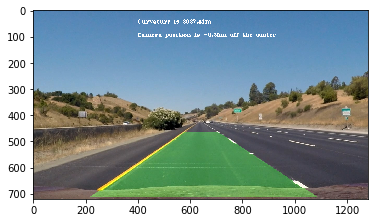

In [35]:
%matplotlib inline
import math
left_line = Line()
right_line = Line()
image = mpimg.imread('test_images/straight_lines1.jpg')
result = pipeline(image)
plt.imshow(result)


In [36]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
# Set up lines for left and right
left_line = Line()
right_line = Line()
white_output = 'white_out.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

True
[MoviePy] >>>> Building video white_out1.mp4
[MoviePy] Writing video white_out1.mp4


  0%|          | 1/1261 [00:00<05:21,  3.92it/s]

False


  0%|          | 2/1261 [00:00<05:21,  3.92it/s]

False


  0%|          | 3/1261 [00:00<05:19,  3.94it/s]

True


  0%|          | 4/1261 [00:01<05:14,  4.00it/s]

True


  0%|          | 5/1261 [00:01<05:15,  3.97it/s]

True


  0%|          | 6/1261 [00:01<05:09,  4.05it/s]

True


  1%|          | 7/1261 [00:01<05:11,  4.02it/s]

True


  1%|          | 8/1261 [00:01<05:09,  4.04it/s]

True


  1%|          | 9/1261 [00:02<05:06,  4.09it/s]

True


  1%|          | 10/1261 [00:02<05:04,  4.11it/s]

True


  1%|          | 11/1261 [00:02<05:01,  4.14it/s]

False


  1%|          | 12/1261 [00:02<05:03,  4.11it/s]

False


  1%|          | 13/1261 [00:03<04:59,  4.16it/s]

True


  1%|          | 14/1261 [00:03<04:58,  4.18it/s]

True


  1%|          | 15/1261 [00:03<05:00,  4.15it/s]

True


  1%|▏         | 16/1261 [00:03<05:02,  4.12it/s]

False


  1%|▏         | 17/1261 [00:04<05:00,  4.14it/s]

False


  1%|▏         | 18/1261 [00:04<05:00,  4.14it/s]

True


  2%|▏         | 19/1261 [00:04<04:58,  4.17it/s]

True


  2%|▏         | 20/1261 [00:04<05:00,  4.13it/s]

False


  2%|▏         | 21/1261 [00:05<04:58,  4.15it/s]

False


  2%|▏         | 22/1261 [00:05<04:58,  4.15it/s]

False


  2%|▏         | 23/1261 [00:05<04:55,  4.18it/s]

False


  2%|▏         | 24/1261 [00:05<04:54,  4.20it/s]

True


  2%|▏         | 25/1261 [00:06<04:54,  4.19it/s]

True


  2%|▏         | 26/1261 [00:06<04:53,  4.20it/s]

True


  2%|▏         | 27/1261 [00:06<04:51,  4.23it/s]

False


  2%|▏         | 28/1261 [00:06<04:49,  4.26it/s]

False


  2%|▏         | 29/1261 [00:07<04:48,  4.27it/s]

True


  2%|▏         | 30/1261 [00:07<04:56,  4.15it/s]

True


  2%|▏         | 31/1261 [00:07<05:00,  4.10it/s]

True


  3%|▎         | 32/1261 [00:07<05:01,  4.08it/s]

True


  3%|▎         | 33/1261 [00:08<05:03,  4.05it/s]

True


  3%|▎         | 34/1261 [00:08<05:05,  4.02it/s]

True


  3%|▎         | 35/1261 [00:08<04:59,  4.09it/s]

True


  3%|▎         | 36/1261 [00:08<05:02,  4.04it/s]

True


  3%|▎         | 37/1261 [00:08<05:01,  4.06it/s]

False


  3%|▎         | 38/1261 [00:09<04:56,  4.13it/s]

False


  3%|▎         | 39/1261 [00:09<04:55,  4.14it/s]

True


  3%|▎         | 40/1261 [00:09<04:57,  4.10it/s]

True


  3%|▎         | 41/1261 [00:09<04:56,  4.12it/s]

True


  3%|▎         | 42/1261 [00:10<04:52,  4.17it/s]

True


  3%|▎         | 43/1261 [00:10<04:53,  4.15it/s]

True


  3%|▎         | 44/1261 [00:10<04:53,  4.14it/s]

True


  4%|▎         | 45/1261 [00:10<04:51,  4.16it/s]

True


  4%|▎         | 46/1261 [00:11<04:52,  4.15it/s]

True


  4%|▎         | 47/1261 [00:11<04:55,  4.11it/s]

True


  4%|▍         | 48/1261 [00:11<04:59,  4.05it/s]

True


  4%|▍         | 49/1261 [00:11<04:58,  4.06it/s]

True


  4%|▍         | 50/1261 [00:12<04:56,  4.08it/s]

False


  4%|▍         | 51/1261 [00:12<05:02,  4.00it/s]

False


  4%|▍         | 52/1261 [00:12<05:03,  3.99it/s]

False


  4%|▍         | 53/1261 [00:12<04:57,  4.06it/s]

True


  4%|▍         | 54/1261 [00:13<04:57,  4.05it/s]

True


  4%|▍         | 55/1261 [00:13<04:54,  4.09it/s]

True


  4%|▍         | 56/1261 [00:13<04:52,  4.13it/s]

True


  5%|▍         | 57/1261 [00:13<04:53,  4.10it/s]

False


  5%|▍         | 58/1261 [00:14<04:54,  4.09it/s]

False


  5%|▍         | 59/1261 [00:14<04:51,  4.13it/s]

False


  5%|▍         | 60/1261 [00:14<04:50,  4.13it/s]

True


  5%|▍         | 61/1261 [00:14<04:50,  4.13it/s]

True


  5%|▍         | 62/1261 [00:15<04:53,  4.09it/s]

True


  5%|▍         | 63/1261 [00:15<04:54,  4.07it/s]

False


  5%|▌         | 64/1261 [00:15<04:57,  4.03it/s]

True


  5%|▌         | 65/1261 [00:15<04:55,  4.05it/s]

False


  5%|▌         | 66/1261 [00:16<04:53,  4.07it/s]

False


  5%|▌         | 67/1261 [00:16<04:50,  4.10it/s]

False


  5%|▌         | 68/1261 [00:16<04:49,  4.13it/s]

True


  5%|▌         | 69/1261 [00:16<04:50,  4.10it/s]

True


  6%|▌         | 70/1261 [00:17<04:45,  4.17it/s]

True


  6%|▌         | 71/1261 [00:17<04:45,  4.17it/s]

True


  6%|▌         | 72/1261 [00:17<04:45,  4.16it/s]

True


  6%|▌         | 73/1261 [00:17<04:47,  4.14it/s]

True


  6%|▌         | 74/1261 [00:17<04:45,  4.16it/s]

True


  6%|▌         | 75/1261 [00:18<04:44,  4.17it/s]

False


  6%|▌         | 76/1261 [00:18<04:45,  4.16it/s]

True


  6%|▌         | 77/1261 [00:18<04:51,  4.06it/s]

True


  6%|▌         | 78/1261 [00:18<04:56,  3.99it/s]

True


  6%|▋         | 79/1261 [00:19<04:55,  4.00it/s]

False


  6%|▋         | 80/1261 [00:19<04:55,  4.00it/s]

True


  6%|▋         | 81/1261 [00:19<04:55,  3.99it/s]

False


  7%|▋         | 82/1261 [00:19<04:56,  3.98it/s]

False


  7%|▋         | 83/1261 [00:20<04:53,  4.02it/s]

False


  7%|▋         | 84/1261 [00:20<04:55,  3.99it/s]

False


  7%|▋         | 85/1261 [00:20<04:54,  4.00it/s]

False


  7%|▋         | 86/1261 [00:20<04:52,  4.02it/s]

False


  7%|▋         | 87/1261 [00:21<04:52,  4.01it/s]

True


  7%|▋         | 88/1261 [00:21<04:50,  4.04it/s]

False


  7%|▋         | 89/1261 [00:21<04:50,  4.04it/s]

False


  7%|▋         | 90/1261 [00:21<04:47,  4.07it/s]

True


  7%|▋         | 91/1261 [00:22<04:50,  4.03it/s]

True


  7%|▋         | 92/1261 [00:22<04:47,  4.06it/s]

True


  7%|▋         | 93/1261 [00:22<04:43,  4.11it/s]

True


  7%|▋         | 94/1261 [00:22<04:40,  4.16it/s]

True


  8%|▊         | 95/1261 [00:23<04:38,  4.19it/s]

True


  8%|▊         | 96/1261 [00:23<04:36,  4.21it/s]

True


  8%|▊         | 97/1261 [00:23<04:46,  4.06it/s]

True


  8%|▊         | 98/1261 [00:23<04:44,  4.09it/s]

True


  8%|▊         | 99/1261 [00:24<04:44,  4.08it/s]

True


  8%|▊         | 100/1261 [00:24<04:47,  4.04it/s]

True


  8%|▊         | 101/1261 [00:24<04:44,  4.08it/s]

True


  8%|▊         | 102/1261 [00:24<04:42,  4.11it/s]

True


  8%|▊         | 103/1261 [00:25<04:46,  4.04it/s]

True


  8%|▊         | 104/1261 [00:25<04:47,  4.03it/s]

True


  8%|▊         | 105/1261 [00:25<04:43,  4.08it/s]

True


  8%|▊         | 106/1261 [00:25<04:39,  4.14it/s]

True


  8%|▊         | 107/1261 [00:26<04:39,  4.13it/s]

True


  9%|▊         | 108/1261 [00:26<04:41,  4.10it/s]

True


  9%|▊         | 109/1261 [00:26<04:38,  4.14it/s]

False


  9%|▊         | 110/1261 [00:26<04:39,  4.12it/s]

True


  9%|▉         | 111/1261 [00:27<04:42,  4.06it/s]

True


  9%|▉         | 112/1261 [00:27<04:44,  4.04it/s]

True


  9%|▉         | 113/1261 [00:27<04:44,  4.03it/s]

True


  9%|▉         | 114/1261 [00:27<04:39,  4.10it/s]

False


  9%|▉         | 115/1261 [00:28<04:36,  4.14it/s]

False


  9%|▉         | 116/1261 [00:28<04:34,  4.18it/s]

True


  9%|▉         | 117/1261 [00:28<04:31,  4.21it/s]

True


  9%|▉         | 118/1261 [00:28<04:31,  4.20it/s]

True


  9%|▉         | 119/1261 [00:29<04:30,  4.22it/s]

True


 10%|▉         | 120/1261 [00:29<04:33,  4.17it/s]

True


 10%|▉         | 121/1261 [00:29<04:39,  4.08it/s]

True


 10%|▉         | 122/1261 [00:29<04:40,  4.06it/s]

True


 10%|▉         | 123/1261 [00:30<04:41,  4.05it/s]

True


 10%|▉         | 124/1261 [00:30<04:41,  4.04it/s]

True


 10%|▉         | 125/1261 [00:30<04:44,  4.00it/s]

True


 10%|▉         | 126/1261 [00:30<04:41,  4.03it/s]

True


 10%|█         | 127/1261 [00:30<04:36,  4.10it/s]

True


 10%|█         | 128/1261 [00:31<04:35,  4.12it/s]

True


 10%|█         | 129/1261 [00:31<04:36,  4.10it/s]

True


 10%|█         | 130/1261 [00:31<04:37,  4.08it/s]

True


 10%|█         | 131/1261 [00:31<04:38,  4.06it/s]

True


 10%|█         | 132/1261 [00:32<04:40,  4.02it/s]

True


 11%|█         | 133/1261 [00:32<04:41,  4.01it/s]

True


 11%|█         | 134/1261 [00:32<04:42,  3.99it/s]

True


 11%|█         | 135/1261 [00:32<04:40,  4.01it/s]

True


 11%|█         | 136/1261 [00:33<04:38,  4.03it/s]

True


 11%|█         | 137/1261 [00:33<04:37,  4.06it/s]

True


 11%|█         | 138/1261 [00:33<04:32,  4.11it/s]

False


 11%|█         | 139/1261 [00:33<04:31,  4.13it/s]

False


 11%|█         | 140/1261 [00:34<04:29,  4.16it/s]

False


 11%|█         | 141/1261 [00:34<04:28,  4.17it/s]

True


 11%|█▏        | 142/1261 [00:34<04:26,  4.19it/s]

True


 11%|█▏        | 143/1261 [00:34<04:26,  4.20it/s]

True


 11%|█▏        | 144/1261 [00:35<04:27,  4.18it/s]

True


 11%|█▏        | 145/1261 [00:35<04:27,  4.17it/s]

True


 12%|█▏        | 146/1261 [00:35<04:27,  4.16it/s]

True


 12%|█▏        | 147/1261 [00:35<04:29,  4.13it/s]

True


 12%|█▏        | 148/1261 [00:36<04:29,  4.12it/s]

False


 12%|█▏        | 149/1261 [00:36<04:29,  4.12it/s]

True


 12%|█▏        | 150/1261 [00:36<04:31,  4.10it/s]

False


 12%|█▏        | 151/1261 [00:36<04:30,  4.10it/s]

False


 12%|█▏        | 152/1261 [00:37<04:29,  4.12it/s]

True


 12%|█▏        | 153/1261 [00:37<04:29,  4.12it/s]

True


 12%|█▏        | 154/1261 [00:37<04:27,  4.14it/s]

True


 12%|█▏        | 155/1261 [00:37<04:25,  4.17it/s]

True


 12%|█▏        | 156/1261 [00:38<04:23,  4.19it/s]

True


 12%|█▏        | 157/1261 [00:38<04:22,  4.21it/s]

False


 13%|█▎        | 158/1261 [00:38<04:21,  4.22it/s]

False


 13%|█▎        | 159/1261 [00:38<04:21,  4.21it/s]

False


 13%|█▎        | 160/1261 [00:38<04:23,  4.19it/s]

True


 13%|█▎        | 161/1261 [00:39<04:21,  4.21it/s]

True


 13%|█▎        | 162/1261 [00:39<04:20,  4.22it/s]

False


 13%|█▎        | 163/1261 [00:39<04:20,  4.21it/s]

False


 13%|█▎        | 164/1261 [00:39<04:20,  4.22it/s]

False


 13%|█▎        | 165/1261 [00:40<04:20,  4.21it/s]

True


 13%|█▎        | 166/1261 [00:40<04:18,  4.23it/s]

False


 13%|█▎        | 167/1261 [00:40<04:19,  4.21it/s]

False


 13%|█▎        | 168/1261 [00:40<04:19,  4.22it/s]

False


 13%|█▎        | 169/1261 [00:41<04:16,  4.25it/s]

True


 13%|█▎        | 170/1261 [00:41<04:16,  4.25it/s]

True


 14%|█▎        | 171/1261 [00:41<04:16,  4.25it/s]

True


 14%|█▎        | 172/1261 [00:41<04:18,  4.21it/s]

False


 14%|█▎        | 173/1261 [00:42<04:18,  4.22it/s]

True


 14%|█▍        | 174/1261 [00:42<04:19,  4.19it/s]

True


 14%|█▍        | 175/1261 [00:42<04:19,  4.18it/s]

True


 14%|█▍        | 176/1261 [00:42<04:18,  4.19it/s]

False


 14%|█▍        | 177/1261 [00:43<04:17,  4.20it/s]

False


 14%|█▍        | 178/1261 [00:43<04:18,  4.18it/s]

False


 14%|█▍        | 179/1261 [00:43<04:18,  4.19it/s]

False


 14%|█▍        | 180/1261 [00:43<04:15,  4.22it/s]

False


 14%|█▍        | 181/1261 [00:43<04:15,  4.23it/s]

False


 14%|█▍        | 182/1261 [00:44<04:16,  4.20it/s]

False


 15%|█▍        | 183/1261 [00:44<04:16,  4.21it/s]

False


 15%|█▍        | 184/1261 [00:44<04:15,  4.21it/s]

True


 15%|█▍        | 185/1261 [00:44<04:14,  4.22it/s]

True


 15%|█▍        | 186/1261 [00:45<04:14,  4.23it/s]

True


 15%|█▍        | 187/1261 [00:45<04:13,  4.24it/s]

True


 15%|█▍        | 188/1261 [00:45<04:13,  4.24it/s]

True


 15%|█▍        | 189/1261 [00:45<04:11,  4.26it/s]

True


 15%|█▌        | 190/1261 [00:46<04:11,  4.26it/s]

True


 15%|█▌        | 191/1261 [00:46<04:14,  4.21it/s]

True


 15%|█▌        | 192/1261 [00:46<04:12,  4.23it/s]

True


 15%|█▌        | 193/1261 [00:46<04:12,  4.24it/s]

True


 15%|█▌        | 194/1261 [00:47<04:10,  4.26it/s]

True


 15%|█▌        | 195/1261 [00:47<04:09,  4.26it/s]

True


 16%|█▌        | 196/1261 [00:47<04:10,  4.25it/s]

True


 16%|█▌        | 197/1261 [00:47<04:12,  4.22it/s]

True


 16%|█▌        | 198/1261 [00:47<04:12,  4.21it/s]

True


 16%|█▌        | 199/1261 [00:48<04:12,  4.20it/s]

True


 16%|█▌        | 200/1261 [00:48<04:13,  4.19it/s]

True


 16%|█▌        | 201/1261 [00:48<04:13,  4.19it/s]

True


 16%|█▌        | 202/1261 [00:48<04:13,  4.17it/s]

False


 16%|█▌        | 203/1261 [00:49<04:12,  4.19it/s]

True


 16%|█▌        | 204/1261 [00:49<04:09,  4.23it/s]

True


 16%|█▋        | 205/1261 [00:49<04:09,  4.24it/s]

True


 16%|█▋        | 206/1261 [00:49<04:09,  4.24it/s]

True


 16%|█▋        | 207/1261 [00:50<04:08,  4.24it/s]

True


 16%|█▋        | 208/1261 [00:50<04:09,  4.23it/s]

True


 17%|█▋        | 209/1261 [00:50<04:10,  4.20it/s]

True


 17%|█▋        | 210/1261 [00:50<04:10,  4.19it/s]

True


 17%|█▋        | 211/1261 [00:51<04:10,  4.19it/s]

True


 17%|█▋        | 212/1261 [00:51<04:10,  4.18it/s]

True


 17%|█▋        | 213/1261 [00:51<04:10,  4.19it/s]

True


 17%|█▋        | 214/1261 [00:51<04:09,  4.19it/s]

True


 17%|█▋        | 215/1261 [00:52<04:08,  4.21it/s]

True


 17%|█▋        | 216/1261 [00:52<04:08,  4.21it/s]

True


 17%|█▋        | 217/1261 [00:52<04:06,  4.23it/s]

True


 17%|█▋        | 218/1261 [00:52<04:07,  4.22it/s]

True


 17%|█▋        | 219/1261 [00:52<04:07,  4.21it/s]

True


 17%|█▋        | 220/1261 [00:53<04:07,  4.21it/s]

True


 18%|█▊        | 221/1261 [00:53<04:06,  4.23it/s]

True


 18%|█▊        | 222/1261 [00:53<04:08,  4.18it/s]

True


 18%|█▊        | 223/1261 [00:53<04:07,  4.19it/s]

True


 18%|█▊        | 224/1261 [00:54<04:10,  4.14it/s]

False


 18%|█▊        | 225/1261 [00:54<04:10,  4.13it/s]

False


 18%|█▊        | 226/1261 [00:54<04:09,  4.14it/s]

False


 18%|█▊        | 227/1261 [00:54<04:07,  4.17it/s]

True


 18%|█▊        | 228/1261 [00:55<04:06,  4.20it/s]

False


 18%|█▊        | 229/1261 [00:55<04:05,  4.20it/s]

False


 18%|█▊        | 230/1261 [00:55<04:05,  4.20it/s]

True


 18%|█▊        | 231/1261 [00:55<04:04,  4.22it/s]

True


 18%|█▊        | 232/1261 [00:56<04:03,  4.22it/s]

True


 18%|█▊        | 233/1261 [00:56<04:04,  4.20it/s]

False


 19%|█▊        | 234/1261 [00:56<04:04,  4.20it/s]

False


 19%|█▊        | 235/1261 [00:56<04:04,  4.19it/s]

True


 19%|█▊        | 236/1261 [00:57<04:03,  4.20it/s]

True


 19%|█▉        | 237/1261 [00:57<04:04,  4.19it/s]

True


 19%|█▉        | 238/1261 [00:57<04:03,  4.20it/s]

False


 19%|█▉        | 239/1261 [00:57<04:02,  4.21it/s]

True


 19%|█▉        | 240/1261 [00:57<04:01,  4.22it/s]

True


 19%|█▉        | 241/1261 [00:58<04:00,  4.24it/s]

True


 19%|█▉        | 242/1261 [00:58<03:59,  4.25it/s]

True


 19%|█▉        | 243/1261 [00:58<03:59,  4.26it/s]

False


 19%|█▉        | 244/1261 [00:58<03:57,  4.28it/s]

True


 19%|█▉        | 245/1261 [00:59<03:57,  4.28it/s]

True


 20%|█▉        | 246/1261 [00:59<03:57,  4.28it/s]

True


 20%|█▉        | 247/1261 [00:59<03:58,  4.24it/s]

True


 20%|█▉        | 248/1261 [00:59<03:58,  4.25it/s]

True


 20%|█▉        | 249/1261 [01:00<03:58,  4.24it/s]

True


 20%|█▉        | 250/1261 [01:00<03:58,  4.24it/s]

True


 20%|█▉        | 251/1261 [01:00<03:59,  4.21it/s]

True


 20%|█▉        | 252/1261 [01:00<03:58,  4.24it/s]

True


 20%|██        | 253/1261 [01:01<03:56,  4.25it/s]

True


 20%|██        | 254/1261 [01:01<03:56,  4.26it/s]

True


 20%|██        | 255/1261 [01:01<03:58,  4.21it/s]

True


 20%|██        | 256/1261 [01:01<03:58,  4.21it/s]

True


 20%|██        | 257/1261 [01:01<03:57,  4.23it/s]

True


 20%|██        | 258/1261 [01:02<03:57,  4.22it/s]

True


 21%|██        | 259/1261 [01:02<03:57,  4.22it/s]

True


 21%|██        | 260/1261 [01:02<03:57,  4.21it/s]

True


 21%|██        | 261/1261 [01:02<03:57,  4.20it/s]

True


 21%|██        | 262/1261 [01:03<03:58,  4.19it/s]

True


 21%|██        | 263/1261 [01:03<03:59,  4.17it/s]

True


 21%|██        | 264/1261 [01:03<04:00,  4.15it/s]

True


 21%|██        | 265/1261 [01:03<04:00,  4.14it/s]

True


 21%|██        | 266/1261 [01:04<04:00,  4.14it/s]

True


 21%|██        | 267/1261 [01:04<04:00,  4.14it/s]

False


 21%|██▏       | 268/1261 [01:04<03:58,  4.16it/s]

False


 21%|██▏       | 269/1261 [01:04<03:57,  4.17it/s]

True


 21%|██▏       | 270/1261 [01:05<03:56,  4.19it/s]

False


 21%|██▏       | 271/1261 [01:05<03:56,  4.18it/s]

True


 22%|██▏       | 272/1261 [01:05<03:55,  4.19it/s]

True


 22%|██▏       | 273/1261 [01:05<03:54,  4.21it/s]

True


 22%|██▏       | 274/1261 [01:06<03:56,  4.18it/s]

True


 22%|██▏       | 275/1261 [01:06<03:56,  4.16it/s]

True


 22%|██▏       | 276/1261 [01:06<03:59,  4.11it/s]

True


 22%|██▏       | 277/1261 [01:06<03:57,  4.14it/s]

True


 22%|██▏       | 278/1261 [01:07<03:57,  4.13it/s]

True


 22%|██▏       | 279/1261 [01:07<03:56,  4.16it/s]

True


 22%|██▏       | 280/1261 [01:07<03:53,  4.20it/s]

True


 22%|██▏       | 281/1261 [01:07<03:51,  4.22it/s]

True


 22%|██▏       | 282/1261 [01:07<03:53,  4.19it/s]

True


 22%|██▏       | 283/1261 [01:08<03:53,  4.18it/s]

True


 23%|██▎       | 284/1261 [01:08<03:51,  4.21it/s]

True


 23%|██▎       | 285/1261 [01:08<03:50,  4.24it/s]

True


 23%|██▎       | 286/1261 [01:08<03:49,  4.25it/s]

False


 23%|██▎       | 287/1261 [01:09<03:48,  4.26it/s]

False


 23%|██▎       | 288/1261 [01:09<03:49,  4.24it/s]

True


 23%|██▎       | 289/1261 [01:09<03:49,  4.24it/s]

True


 23%|██▎       | 290/1261 [01:09<03:48,  4.24it/s]

True


 23%|██▎       | 291/1261 [01:10<03:47,  4.26it/s]

False


 23%|██▎       | 292/1261 [01:10<03:47,  4.25it/s]

True


 23%|██▎       | 293/1261 [01:10<03:49,  4.22it/s]

False


 23%|██▎       | 294/1261 [01:10<03:48,  4.23it/s]

True


 23%|██▎       | 295/1261 [01:11<03:48,  4.24it/s]

True


 23%|██▎       | 296/1261 [01:11<03:47,  4.25it/s]

True


 24%|██▎       | 297/1261 [01:11<03:47,  4.24it/s]

True


 24%|██▎       | 298/1261 [01:11<03:48,  4.21it/s]

False


 24%|██▎       | 299/1261 [01:11<03:49,  4.20it/s]

True


 24%|██▍       | 300/1261 [01:12<03:50,  4.17it/s]

True


 24%|██▍       | 301/1261 [01:12<03:52,  4.13it/s]

True


 24%|██▍       | 302/1261 [01:12<03:50,  4.17it/s]

True


 24%|██▍       | 303/1261 [01:12<03:48,  4.20it/s]

True


 24%|██▍       | 304/1261 [01:13<03:47,  4.21it/s]

False


 24%|██▍       | 305/1261 [01:13<03:45,  4.23it/s]

False


 24%|██▍       | 306/1261 [01:13<03:46,  4.22it/s]

True


 24%|██▍       | 307/1261 [01:13<03:44,  4.25it/s]

True


 24%|██▍       | 308/1261 [01:14<03:44,  4.25it/s]

True


 25%|██▍       | 309/1261 [01:14<03:44,  4.25it/s]

True


 25%|██▍       | 310/1261 [01:14<03:43,  4.25it/s]

False


 25%|██▍       | 311/1261 [01:14<03:43,  4.24it/s]

True


 25%|██▍       | 312/1261 [01:15<03:46,  4.18it/s]

True


 25%|██▍       | 313/1261 [01:15<03:47,  4.17it/s]

True


 25%|██▍       | 314/1261 [01:15<03:47,  4.17it/s]

True


 25%|██▍       | 315/1261 [01:15<03:46,  4.18it/s]

True


 25%|██▌       | 316/1261 [01:16<03:44,  4.20it/s]

True


 25%|██▌       | 317/1261 [01:16<03:44,  4.20it/s]

True


 25%|██▌       | 318/1261 [01:16<03:47,  4.15it/s]

False


 25%|██▌       | 319/1261 [01:16<03:45,  4.19it/s]

True


 25%|██▌       | 320/1261 [01:16<03:45,  4.17it/s]

False


 25%|██▌       | 321/1261 [01:17<03:45,  4.17it/s]

False


 26%|██▌       | 322/1261 [01:17<03:46,  4.15it/s]

False


 26%|██▌       | 323/1261 [01:17<03:44,  4.18it/s]

True


 26%|██▌       | 324/1261 [01:17<03:46,  4.14it/s]

False


 26%|██▌       | 325/1261 [01:18<03:47,  4.12it/s]

False


 26%|██▌       | 326/1261 [01:18<03:46,  4.13it/s]

False


 26%|██▌       | 327/1261 [01:18<03:44,  4.17it/s]

False


 26%|██▌       | 328/1261 [01:18<03:42,  4.19it/s]

False


 26%|██▌       | 329/1261 [01:19<03:41,  4.22it/s]

False


 26%|██▌       | 330/1261 [01:19<03:40,  4.23it/s]

False


 26%|██▌       | 331/1261 [01:19<03:39,  4.24it/s]

True


 26%|██▋       | 332/1261 [01:19<03:39,  4.24it/s]

True


 26%|██▋       | 333/1261 [01:20<03:39,  4.24it/s]

False


 26%|██▋       | 334/1261 [01:20<03:40,  4.21it/s]

True


 27%|██▋       | 335/1261 [01:20<03:39,  4.22it/s]

False


 27%|██▋       | 336/1261 [01:20<03:40,  4.19it/s]

False


 27%|██▋       | 337/1261 [01:21<03:42,  4.14it/s]

True


 27%|██▋       | 338/1261 [01:21<03:44,  4.11it/s]

True


 27%|██▋       | 339/1261 [01:21<03:43,  4.13it/s]

False


 27%|██▋       | 340/1261 [01:21<03:41,  4.15it/s]

False


 27%|██▋       | 341/1261 [01:22<03:39,  4.19it/s]

False


 27%|██▋       | 342/1261 [01:22<03:41,  4.15it/s]

False


 27%|██▋       | 343/1261 [01:22<03:41,  4.15it/s]

False


 27%|██▋       | 344/1261 [01:22<03:46,  4.06it/s]

False


 27%|██▋       | 345/1261 [01:23<03:42,  4.11it/s]

False


 27%|██▋       | 346/1261 [01:23<03:39,  4.16it/s]

False


 28%|██▊       | 347/1261 [01:23<03:38,  4.19it/s]

False


 28%|██▊       | 348/1261 [01:23<03:39,  4.16it/s]

False


 28%|██▊       | 349/1261 [01:23<03:38,  4.18it/s]

True


 28%|██▊       | 350/1261 [01:24<03:37,  4.18it/s]

True


 28%|██▊       | 351/1261 [01:24<03:36,  4.20it/s]

True


 28%|██▊       | 352/1261 [01:24<03:35,  4.22it/s]

False


 28%|██▊       | 353/1261 [01:24<03:35,  4.21it/s]

False


 28%|██▊       | 354/1261 [01:25<03:37,  4.17it/s]

False


 28%|██▊       | 355/1261 [01:25<03:35,  4.20it/s]

False


 28%|██▊       | 356/1261 [01:25<03:35,  4.21it/s]

True


 28%|██▊       | 357/1261 [01:25<03:35,  4.20it/s]

True


 28%|██▊       | 358/1261 [01:26<03:33,  4.22it/s]

True


 28%|██▊       | 359/1261 [01:26<03:33,  4.23it/s]

True


 29%|██▊       | 360/1261 [01:26<03:33,  4.22it/s]

False


 29%|██▊       | 361/1261 [01:26<03:32,  4.23it/s]

False


 29%|██▊       | 362/1261 [01:27<03:34,  4.20it/s]

False


 29%|██▉       | 363/1261 [01:27<03:37,  4.13it/s]

False


 29%|██▉       | 364/1261 [01:27<03:36,  4.14it/s]

False


 29%|██▉       | 365/1261 [01:27<03:34,  4.18it/s]

True


 29%|██▉       | 366/1261 [01:28<03:33,  4.20it/s]

False


 29%|██▉       | 367/1261 [01:28<03:32,  4.21it/s]

True


 29%|██▉       | 368/1261 [01:28<03:31,  4.22it/s]

False


 29%|██▉       | 369/1261 [01:28<03:33,  4.18it/s]

False


 29%|██▉       | 370/1261 [01:28<03:33,  4.17it/s]

False


 29%|██▉       | 371/1261 [01:29<03:31,  4.21it/s]

False


 30%|██▉       | 372/1261 [01:29<03:29,  4.24it/s]

False


 30%|██▉       | 373/1261 [01:29<03:30,  4.22it/s]

True


 30%|██▉       | 374/1261 [01:29<03:30,  4.21it/s]

False


 30%|██▉       | 375/1261 [01:30<03:30,  4.20it/s]

True


 30%|██▉       | 376/1261 [01:30<03:30,  4.21it/s]

False


 30%|██▉       | 377/1261 [01:30<03:30,  4.20it/s]

True


 30%|██▉       | 378/1261 [01:30<03:30,  4.18it/s]

False


 30%|███       | 379/1261 [01:31<03:29,  4.21it/s]

False


 30%|███       | 380/1261 [01:31<03:31,  4.16it/s]

False


 30%|███       | 381/1261 [01:31<03:29,  4.20it/s]

False


 30%|███       | 382/1261 [01:31<03:29,  4.19it/s]

False


 30%|███       | 383/1261 [01:32<03:28,  4.20it/s]

False


 30%|███       | 384/1261 [01:32<03:27,  4.22it/s]

True


 31%|███       | 385/1261 [01:32<03:28,  4.20it/s]

True


 31%|███       | 386/1261 [01:32<03:26,  4.23it/s]

True


 31%|███       | 387/1261 [01:32<03:26,  4.24it/s]

True


 31%|███       | 388/1261 [01:33<03:25,  4.24it/s]

True


 31%|███       | 389/1261 [01:33<03:26,  4.23it/s]

False


 31%|███       | 390/1261 [01:33<03:27,  4.20it/s]

False


 31%|███       | 391/1261 [01:33<03:28,  4.17it/s]

False


 31%|███       | 392/1261 [01:34<03:26,  4.20it/s]

False


 31%|███       | 393/1261 [01:34<03:25,  4.22it/s]

False


 31%|███       | 394/1261 [01:34<03:24,  4.24it/s]

False


 31%|███▏      | 395/1261 [01:34<03:24,  4.23it/s]

False


 31%|███▏      | 396/1261 [01:35<03:24,  4.23it/s]

True


 31%|███▏      | 397/1261 [01:35<03:23,  4.24it/s]

False


 32%|███▏      | 398/1261 [01:35<03:23,  4.25it/s]

False


 32%|███▏      | 399/1261 [01:35<03:24,  4.23it/s]

True


 32%|███▏      | 400/1261 [01:36<03:22,  4.24it/s]

True


 32%|███▏      | 401/1261 [01:36<03:22,  4.24it/s]

True


 32%|███▏      | 402/1261 [01:36<03:24,  4.19it/s]

False


 32%|███▏      | 403/1261 [01:36<03:23,  4.21it/s]

False


 32%|███▏      | 404/1261 [01:37<03:23,  4.21it/s]

True


 32%|███▏      | 405/1261 [01:37<03:25,  4.17it/s]

False


 32%|███▏      | 406/1261 [01:37<03:28,  4.10it/s]

False


 32%|███▏      | 407/1261 [01:37<03:25,  4.16it/s]

False


 32%|███▏      | 408/1261 [01:37<03:25,  4.15it/s]

False


 32%|███▏      | 409/1261 [01:38<03:23,  4.19it/s]

False


 33%|███▎      | 410/1261 [01:38<03:23,  4.19it/s]

True


 33%|███▎      | 411/1261 [01:38<03:21,  4.22it/s]

True


 33%|███▎      | 412/1261 [01:38<03:22,  4.20it/s]

True


 33%|███▎      | 413/1261 [01:39<03:20,  4.23it/s]

False


 33%|███▎      | 414/1261 [01:39<03:20,  4.22it/s]

False


 33%|███▎      | 415/1261 [01:39<03:21,  4.20it/s]

False


 33%|███▎      | 416/1261 [01:39<03:24,  4.14it/s]

False


 33%|███▎      | 417/1261 [01:40<03:22,  4.17it/s]

False


 33%|███▎      | 418/1261 [01:40<03:20,  4.20it/s]

False


 33%|███▎      | 419/1261 [01:40<03:19,  4.22it/s]

False


 33%|███▎      | 420/1261 [01:40<03:18,  4.24it/s]

False


 33%|███▎      | 421/1261 [01:41<03:19,  4.22it/s]

True


 33%|███▎      | 422/1261 [01:41<03:18,  4.23it/s]

True


 34%|███▎      | 423/1261 [01:41<03:19,  4.19it/s]

True


 34%|███▎      | 424/1261 [01:41<03:18,  4.22it/s]

False


 34%|███▎      | 425/1261 [01:42<03:17,  4.23it/s]

True


 34%|███▍      | 426/1261 [01:42<03:17,  4.24it/s]

True


 34%|███▍      | 427/1261 [01:42<03:16,  4.24it/s]

False


 34%|███▍      | 428/1261 [01:42<03:16,  4.24it/s]

True


 34%|███▍      | 429/1261 [01:42<03:18,  4.20it/s]

False


 34%|███▍      | 430/1261 [01:43<03:16,  4.23it/s]

False


 34%|███▍      | 431/1261 [01:43<03:16,  4.23it/s]

False


 34%|███▍      | 432/1261 [01:43<03:17,  4.20it/s]

False


 34%|███▍      | 433/1261 [01:43<03:15,  4.23it/s]

False


 34%|███▍      | 434/1261 [01:44<03:15,  4.24it/s]

False


 34%|███▍      | 435/1261 [01:44<03:16,  4.21it/s]

False


 35%|███▍      | 436/1261 [01:44<03:17,  4.18it/s]

False


 35%|███▍      | 437/1261 [01:44<03:17,  4.18it/s]

False


 35%|███▍      | 438/1261 [01:45<03:16,  4.19it/s]

False


 35%|███▍      | 439/1261 [01:45<03:15,  4.21it/s]

False


 35%|███▍      | 440/1261 [01:45<03:14,  4.22it/s]

False


 35%|███▍      | 441/1261 [01:45<03:13,  4.23it/s]

True


 35%|███▌      | 442/1261 [01:46<03:13,  4.23it/s]

True


 35%|███▌      | 443/1261 [01:46<03:12,  4.25it/s]

False


 35%|███▌      | 444/1261 [01:46<03:13,  4.23it/s]

True


 35%|███▌      | 445/1261 [01:46<03:12,  4.24it/s]

False


 35%|███▌      | 446/1261 [01:46<03:11,  4.26it/s]

False


 35%|███▌      | 447/1261 [01:47<03:10,  4.26it/s]

True


 36%|███▌      | 448/1261 [01:47<03:10,  4.27it/s]

True


 36%|███▌      | 449/1261 [01:47<03:09,  4.29it/s]

False


 36%|███▌      | 450/1261 [01:47<03:09,  4.29it/s]

False


 36%|███▌      | 451/1261 [01:48<03:10,  4.26it/s]

False


 36%|███▌      | 452/1261 [01:48<03:11,  4.22it/s]

True


 36%|███▌      | 453/1261 [01:48<03:12,  4.19it/s]

False


 36%|███▌      | 454/1261 [01:48<03:13,  4.17it/s]

False


 36%|███▌      | 455/1261 [01:49<03:14,  4.15it/s]

False


 36%|███▌      | 456/1261 [01:49<03:13,  4.16it/s]

False


 36%|███▌      | 457/1261 [01:49<03:11,  4.21it/s]

False


 36%|███▋      | 458/1261 [01:49<03:10,  4.21it/s]

False


 36%|███▋      | 459/1261 [01:50<03:10,  4.22it/s]

False


 36%|███▋      | 460/1261 [01:50<03:11,  4.18it/s]

False


 37%|███▋      | 461/1261 [01:50<03:10,  4.19it/s]

False


 37%|███▋      | 462/1261 [01:50<03:10,  4.19it/s]

False


 37%|███▋      | 463/1261 [01:51<03:11,  4.16it/s]

False


 37%|███▋      | 464/1261 [01:51<03:11,  4.16it/s]

False


 37%|███▋      | 465/1261 [01:51<03:11,  4.15it/s]

False


 37%|███▋      | 466/1261 [01:51<03:09,  4.20it/s]

False


 37%|███▋      | 467/1261 [01:51<03:09,  4.19it/s]

True


 37%|███▋      | 468/1261 [01:52<03:08,  4.22it/s]

True


 37%|███▋      | 469/1261 [01:52<03:06,  4.24it/s]

True


 37%|███▋      | 470/1261 [01:52<03:05,  4.26it/s]

True


 37%|███▋      | 471/1261 [01:52<03:05,  4.27it/s]

True


 37%|███▋      | 472/1261 [01:53<03:05,  4.26it/s]

True


 38%|███▊      | 473/1261 [01:53<03:05,  4.26it/s]

True


 38%|███▊      | 474/1261 [01:53<03:07,  4.20it/s]

True


 38%|███▊      | 475/1261 [01:53<03:07,  4.18it/s]

True


 38%|███▊      | 476/1261 [01:54<03:06,  4.21it/s]

False


 38%|███▊      | 477/1261 [01:54<03:06,  4.21it/s]

False


 38%|███▊      | 478/1261 [01:54<03:06,  4.19it/s]

False


 38%|███▊      | 479/1261 [01:54<03:06,  4.20it/s]

False


 38%|███▊      | 480/1261 [01:55<03:07,  4.17it/s]

False


 38%|███▊      | 481/1261 [01:55<03:09,  4.12it/s]

True


 38%|███▊      | 482/1261 [01:55<03:08,  4.13it/s]

False


 38%|███▊      | 483/1261 [01:55<03:08,  4.13it/s]

False


 38%|███▊      | 484/1261 [01:56<03:05,  4.18it/s]

False


 38%|███▊      | 485/1261 [01:56<03:04,  4.20it/s]

False


 39%|███▊      | 486/1261 [01:56<03:05,  4.17it/s]

False


 39%|███▊      | 487/1261 [01:56<03:04,  4.20it/s]

True


 39%|███▊      | 488/1261 [01:57<03:04,  4.19it/s]

False


 39%|███▉      | 489/1261 [01:57<03:03,  4.22it/s]

False


 39%|███▉      | 490/1261 [01:57<03:03,  4.20it/s]

False


 39%|███▉      | 491/1261 [01:57<03:05,  4.16it/s]

False


 39%|███▉      | 492/1261 [01:57<03:07,  4.10it/s]

True


 39%|███▉      | 493/1261 [01:58<03:09,  4.06it/s]

False


 39%|███▉      | 494/1261 [01:58<03:09,  4.04it/s]

False


 39%|███▉      | 495/1261 [01:58<03:09,  4.04it/s]

False


 39%|███▉      | 496/1261 [01:58<03:08,  4.05it/s]

False


 39%|███▉      | 497/1261 [01:59<03:09,  4.04it/s]

False


 39%|███▉      | 498/1261 [01:59<03:09,  4.02it/s]

False


 40%|███▉      | 499/1261 [01:59<03:10,  4.00it/s]

False


 40%|███▉      | 500/1261 [01:59<03:10,  4.00it/s]

False


 40%|███▉      | 501/1261 [02:00<03:10,  3.99it/s]

False


 40%|███▉      | 502/1261 [02:00<03:09,  4.00it/s]

False


 40%|███▉      | 503/1261 [02:00<03:08,  4.03it/s]

False


 40%|███▉      | 504/1261 [02:00<03:08,  4.02it/s]

False


 40%|████      | 505/1261 [02:01<03:09,  3.99it/s]

False


 40%|████      | 506/1261 [02:01<03:09,  3.99it/s]

False


 40%|████      | 507/1261 [02:01<03:07,  4.02it/s]

False


 40%|████      | 508/1261 [02:01<03:07,  4.02it/s]

False


 40%|████      | 509/1261 [02:02<03:05,  4.06it/s]

False


 40%|████      | 510/1261 [02:02<03:06,  4.03it/s]

False


 41%|████      | 511/1261 [02:02<03:06,  4.02it/s]

False


 41%|████      | 512/1261 [02:02<03:07,  3.99it/s]

True


 41%|████      | 513/1261 [02:03<03:07,  3.99it/s]

True


 41%|████      | 514/1261 [02:03<03:08,  3.96it/s]

False


 41%|████      | 515/1261 [02:03<03:10,  3.91it/s]

False


 41%|████      | 516/1261 [02:03<03:11,  3.89it/s]

False


 41%|████      | 517/1261 [02:04<03:11,  3.89it/s]

False


 41%|████      | 518/1261 [02:04<03:07,  3.96it/s]

False


 41%|████      | 519/1261 [02:04<03:05,  4.00it/s]

False


 41%|████      | 520/1261 [02:04<03:06,  3.98it/s]

True


 41%|████▏     | 521/1261 [02:05<03:06,  3.98it/s]

False


 41%|████▏     | 522/1261 [02:05<03:04,  4.01it/s]

False


 41%|████▏     | 523/1261 [02:05<03:03,  4.03it/s]

False


 42%|████▏     | 524/1261 [02:05<03:03,  4.03it/s]

True


 42%|████▏     | 525/1261 [02:06<03:03,  4.00it/s]

False


 42%|████▏     | 526/1261 [02:06<03:03,  4.00it/s]

False


 42%|████▏     | 527/1261 [02:06<03:06,  3.93it/s]

False


 42%|████▏     | 528/1261 [02:06<03:04,  3.97it/s]

False


 42%|████▏     | 529/1261 [02:07<03:04,  3.97it/s]

False


 42%|████▏     | 530/1261 [02:07<03:03,  3.97it/s]

False


 42%|████▏     | 531/1261 [02:07<03:04,  3.96it/s]

False


 42%|████▏     | 532/1261 [02:08<03:05,  3.93it/s]

False


 42%|████▏     | 533/1261 [02:08<03:05,  3.93it/s]

False


 42%|████▏     | 534/1261 [02:08<03:04,  3.95it/s]

False


 42%|████▏     | 535/1261 [02:08<03:03,  3.97it/s]

False


 43%|████▎     | 536/1261 [02:09<03:02,  3.96it/s]

True


 43%|████▎     | 537/1261 [02:09<03:01,  3.98it/s]

False


 43%|████▎     | 538/1261 [02:09<03:03,  3.93it/s]

False


 43%|████▎     | 539/1261 [02:09<03:00,  4.00it/s]

True


 43%|████▎     | 540/1261 [02:10<02:57,  4.05it/s]

False


 43%|████▎     | 541/1261 [02:10<02:56,  4.08it/s]

False


 43%|████▎     | 542/1261 [02:10<03:00,  3.98it/s]

False


 43%|████▎     | 543/1261 [02:10<03:22,  3.55it/s]

False


 43%|████▎     | 544/1261 [02:11<03:24,  3.51it/s]

False


 43%|████▎     | 545/1261 [02:11<03:23,  3.53it/s]

False


 43%|████▎     | 546/1261 [02:11<03:31,  3.38it/s]

False


 43%|████▎     | 547/1261 [02:12<03:38,  3.27it/s]

False


 43%|████▎     | 548/1261 [02:12<03:42,  3.20it/s]

False


 44%|████▎     | 549/1261 [02:12<03:44,  3.17it/s]

False


 44%|████▎     | 550/1261 [02:13<03:37,  3.26it/s]

False


 44%|████▎     | 551/1261 [02:13<03:35,  3.30it/s]

False


 44%|████▍     | 552/1261 [02:13<03:41,  3.21it/s]

False


 44%|████▍     | 553/1261 [02:13<03:32,  3.33it/s]

False


 44%|████▍     | 554/1261 [02:14<03:26,  3.42it/s]

False


 44%|████▍     | 555/1261 [02:14<03:17,  3.57it/s]

False


 44%|████▍     | 556/1261 [02:14<03:11,  3.68it/s]

False


 44%|████▍     | 557/1261 [02:14<03:08,  3.74it/s]

False


 44%|████▍     | 558/1261 [02:15<03:06,  3.76it/s]

False


 44%|████▍     | 559/1261 [02:15<03:08,  3.72it/s]

False


 44%|████▍     | 560/1261 [02:15<03:06,  3.76it/s]

False


 44%|████▍     | 561/1261 [02:16<03:03,  3.82it/s]

True


 45%|████▍     | 562/1261 [02:16<03:02,  3.84it/s]

False


 45%|████▍     | 563/1261 [02:16<03:00,  3.86it/s]

False


 45%|████▍     | 564/1261 [02:16<02:57,  3.92it/s]

False


 45%|████▍     | 565/1261 [02:17<02:54,  3.99it/s]

False


 45%|████▍     | 566/1261 [02:17<02:54,  3.99it/s]

True


 45%|████▍     | 567/1261 [02:17<02:52,  4.03it/s]

True


 45%|████▌     | 568/1261 [02:17<03:00,  3.84it/s]

False


 45%|████▌     | 569/1261 [02:18<03:00,  3.84it/s]

False


 45%|████▌     | 570/1261 [02:18<03:00,  3.83it/s]

False


 45%|████▌     | 571/1261 [02:18<02:59,  3.85it/s]

False


 45%|████▌     | 572/1261 [02:18<03:07,  3.68it/s]

False


 45%|████▌     | 573/1261 [02:19<03:04,  3.73it/s]

False


 46%|████▌     | 574/1261 [02:19<03:00,  3.81it/s]

False


 46%|████▌     | 575/1261 [02:19<02:58,  3.84it/s]

True


 46%|████▌     | 576/1261 [02:19<02:57,  3.85it/s]

False


 46%|████▌     | 577/1261 [02:20<02:55,  3.90it/s]

True


 46%|████▌     | 578/1261 [02:20<02:58,  3.82it/s]

False


 46%|████▌     | 579/1261 [02:20<03:00,  3.77it/s]

False


 46%|████▌     | 580/1261 [02:20<02:56,  3.86it/s]

True


 46%|████▌     | 581/1261 [02:21<02:51,  3.96it/s]

True


 46%|████▌     | 582/1261 [02:21<02:52,  3.94it/s]

False


 46%|████▌     | 583/1261 [02:21<02:51,  3.95it/s]

True


 46%|████▋     | 584/1261 [02:21<02:50,  3.97it/s]

False


 46%|████▋     | 585/1261 [02:22<02:49,  3.99it/s]

True


 46%|████▋     | 586/1261 [02:22<02:49,  3.99it/s]

True


 47%|████▋     | 587/1261 [02:22<02:48,  4.00it/s]

True


 47%|████▋     | 588/1261 [02:22<02:48,  3.98it/s]

False


 47%|████▋     | 589/1261 [02:23<02:48,  4.00it/s]

False


 47%|████▋     | 590/1261 [02:23<02:49,  3.96it/s]

False


 47%|████▋     | 591/1261 [02:23<02:51,  3.91it/s]

False


 47%|████▋     | 592/1261 [02:23<02:52,  3.87it/s]

False


 47%|████▋     | 593/1261 [02:24<02:52,  3.88it/s]

True


 47%|████▋     | 594/1261 [02:24<02:50,  3.92it/s]

False


 47%|████▋     | 595/1261 [02:24<02:49,  3.94it/s]

True


 47%|████▋     | 596/1261 [02:24<02:44,  4.05it/s]

False


 47%|████▋     | 597/1261 [02:25<02:43,  4.05it/s]

False


 47%|████▋     | 598/1261 [02:25<02:44,  4.03it/s]

False


 48%|████▊     | 599/1261 [02:25<02:43,  4.04it/s]

False


 48%|████▊     | 600/1261 [02:25<02:43,  4.05it/s]

False


 48%|████▊     | 601/1261 [02:26<02:42,  4.05it/s]

False


 48%|████▊     | 602/1261 [02:26<02:52,  3.82it/s]

False


 48%|████▊     | 603/1261 [02:26<02:47,  3.94it/s]

False


 48%|████▊     | 604/1261 [02:26<02:45,  3.98it/s]

False


 48%|████▊     | 605/1261 [02:27<02:41,  4.05it/s]

False


 48%|████▊     | 606/1261 [02:27<02:43,  4.01it/s]

True


 48%|████▊     | 607/1261 [02:27<02:44,  3.99it/s]

True


 48%|████▊     | 608/1261 [02:27<02:45,  3.95it/s]

True


 48%|████▊     | 609/1261 [02:28<02:47,  3.89it/s]

True


 48%|████▊     | 610/1261 [02:28<02:47,  3.89it/s]

True


 48%|████▊     | 611/1261 [02:28<02:44,  3.96it/s]

True


 49%|████▊     | 612/1261 [02:28<02:44,  3.95it/s]

True


 49%|████▊     | 613/1261 [02:29<02:43,  3.96it/s]

True


 49%|████▊     | 614/1261 [02:29<02:43,  3.96it/s]

True


 49%|████▉     | 615/1261 [02:29<02:43,  3.95it/s]

False


 49%|████▉     | 616/1261 [02:30<02:43,  3.94it/s]

True


 49%|████▉     | 617/1261 [02:30<02:41,  3.99it/s]

False


 49%|████▉     | 618/1261 [02:30<02:40,  4.00it/s]

True


 49%|████▉     | 619/1261 [02:30<02:55,  3.65it/s]

True


 49%|████▉     | 620/1261 [02:31<02:50,  3.75it/s]

True


 49%|████▉     | 621/1261 [02:31<02:48,  3.79it/s]

True


 49%|████▉     | 622/1261 [02:31<02:46,  3.84it/s]

True


 49%|████▉     | 623/1261 [02:31<02:46,  3.84it/s]

False


 49%|████▉     | 624/1261 [02:32<02:43,  3.90it/s]

False


 50%|████▉     | 625/1261 [02:32<02:42,  3.91it/s]

False


 50%|████▉     | 626/1261 [02:32<02:42,  3.91it/s]

False


 50%|████▉     | 627/1261 [02:32<02:43,  3.87it/s]

False


 50%|████▉     | 628/1261 [02:33<02:47,  3.79it/s]

True


 50%|████▉     | 629/1261 [02:33<02:50,  3.72it/s]

True


 50%|████▉     | 630/1261 [02:33<02:48,  3.74it/s]

True


 50%|█████     | 631/1261 [02:33<02:46,  3.78it/s]

True


 50%|█████     | 632/1261 [02:34<02:45,  3.81it/s]

True


 50%|█████     | 633/1261 [02:34<02:44,  3.81it/s]

True


 50%|█████     | 634/1261 [02:34<02:44,  3.81it/s]

True


 50%|█████     | 635/1261 [02:34<02:43,  3.83it/s]

True


 50%|█████     | 636/1261 [02:35<02:42,  3.84it/s]

True


 51%|█████     | 637/1261 [02:35<02:41,  3.86it/s]

True


 51%|█████     | 638/1261 [02:35<02:39,  3.91it/s]

True


 51%|█████     | 639/1261 [02:36<02:38,  3.93it/s]

True


 51%|█████     | 640/1261 [02:36<02:35,  3.99it/s]

True


 51%|█████     | 641/1261 [02:36<02:34,  4.00it/s]

True


 51%|█████     | 642/1261 [02:36<02:34,  4.02it/s]

True


 51%|█████     | 643/1261 [02:37<02:37,  3.92it/s]

True


 51%|█████     | 644/1261 [02:37<02:39,  3.88it/s]

True


 51%|█████     | 645/1261 [02:37<02:36,  3.93it/s]

False


 51%|█████     | 646/1261 [02:37<02:36,  3.93it/s]

False


 51%|█████▏    | 647/1261 [02:38<02:33,  3.99it/s]

False


 51%|█████▏    | 648/1261 [02:38<02:33,  3.99it/s]

False


 51%|█████▏    | 649/1261 [02:38<02:33,  3.98it/s]

False


 52%|█████▏    | 650/1261 [02:38<02:34,  3.96it/s]

False


 52%|█████▏    | 651/1261 [02:39<02:32,  4.01it/s]

False


 52%|█████▏    | 652/1261 [02:39<02:30,  4.05it/s]

False


 52%|█████▏    | 653/1261 [02:39<02:31,  4.03it/s]

True


 52%|█████▏    | 654/1261 [02:39<02:30,  4.04it/s]

True


 52%|█████▏    | 655/1261 [02:40<02:29,  4.05it/s]

True


 52%|█████▏    | 656/1261 [02:40<02:29,  4.03it/s]

True


 52%|█████▏    | 657/1261 [02:40<02:31,  3.98it/s]

True


 52%|█████▏    | 658/1261 [02:40<02:31,  3.97it/s]

True


 52%|█████▏    | 659/1261 [02:41<02:34,  3.90it/s]

True


 52%|█████▏    | 660/1261 [02:41<02:33,  3.93it/s]

True


 52%|█████▏    | 661/1261 [02:41<02:31,  3.97it/s]

True


 52%|█████▏    | 662/1261 [02:41<02:29,  4.01it/s]

True


 53%|█████▎    | 663/1261 [02:42<02:27,  4.04it/s]

True


 53%|█████▎    | 664/1261 [02:42<02:28,  4.03it/s]

True


 53%|█████▎    | 665/1261 [02:42<02:28,  4.01it/s]

True


 53%|█████▎    | 666/1261 [02:42<02:29,  3.99it/s]

True


 53%|█████▎    | 667/1261 [02:43<02:28,  3.99it/s]

True


 53%|█████▎    | 668/1261 [02:43<02:27,  4.01it/s]

True


 53%|█████▎    | 669/1261 [02:43<02:28,  3.98it/s]

True


 53%|█████▎    | 670/1261 [02:43<02:28,  3.99it/s]

True


 53%|█████▎    | 671/1261 [02:44<02:26,  4.01it/s]

True


 53%|█████▎    | 672/1261 [02:44<02:30,  3.92it/s]

True


 53%|█████▎    | 673/1261 [02:44<02:26,  4.00it/s]

True


 53%|█████▎    | 674/1261 [02:44<02:24,  4.06it/s]

True


 54%|█████▎    | 675/1261 [02:45<02:25,  4.03it/s]

True


 54%|█████▎    | 676/1261 [02:45<02:26,  3.99it/s]

True


 54%|█████▎    | 677/1261 [02:45<02:26,  3.97it/s]

True


 54%|█████▍    | 678/1261 [02:45<02:27,  3.95it/s]

True


 54%|█████▍    | 679/1261 [02:46<02:27,  3.96it/s]

True


 54%|█████▍    | 680/1261 [02:46<02:25,  3.99it/s]

True


 54%|█████▍    | 681/1261 [02:46<02:26,  3.95it/s]

True


 54%|█████▍    | 682/1261 [02:46<02:28,  3.89it/s]

False


 54%|█████▍    | 683/1261 [02:47<02:29,  3.87it/s]

False


 54%|█████▍    | 684/1261 [02:47<02:28,  3.89it/s]

False


 54%|█████▍    | 685/1261 [02:47<02:26,  3.94it/s]

False


 54%|█████▍    | 686/1261 [02:47<02:24,  3.97it/s]

True


 54%|█████▍    | 687/1261 [02:48<02:24,  3.98it/s]

True


 55%|█████▍    | 688/1261 [02:48<02:23,  3.99it/s]

True


 55%|█████▍    | 689/1261 [02:48<02:22,  4.02it/s]

False


 55%|█████▍    | 690/1261 [02:48<02:21,  4.05it/s]

True


 55%|█████▍    | 691/1261 [02:49<02:22,  4.00it/s]

True


 55%|█████▍    | 692/1261 [02:49<02:21,  4.02it/s]

False


 55%|█████▍    | 693/1261 [02:49<02:21,  4.02it/s]

False


 55%|█████▌    | 694/1261 [02:49<02:20,  4.03it/s]

False


 55%|█████▌    | 695/1261 [02:50<02:20,  4.04it/s]

False


 55%|█████▌    | 696/1261 [02:50<02:20,  4.03it/s]

True


 55%|█████▌    | 697/1261 [02:50<02:21,  3.99it/s]

True


 55%|█████▌    | 698/1261 [02:50<02:21,  3.99it/s]

True


 55%|█████▌    | 699/1261 [02:51<02:28,  3.78it/s]

True


 56%|█████▌    | 700/1261 [02:51<02:26,  3.83it/s]

True


 56%|█████▌    | 701/1261 [02:51<02:24,  3.88it/s]

True


 56%|█████▌    | 702/1261 [02:51<02:25,  3.85it/s]

True


 56%|█████▌    | 703/1261 [02:52<02:22,  3.91it/s]

False


 56%|█████▌    | 704/1261 [02:52<02:20,  3.96it/s]

False


 56%|█████▌    | 705/1261 [02:52<02:20,  3.96it/s]

False


 56%|█████▌    | 706/1261 [02:52<02:20,  3.96it/s]

False


 56%|█████▌    | 707/1261 [02:53<02:19,  3.97it/s]

False


 56%|█████▌    | 708/1261 [02:53<02:19,  3.96it/s]

False


 56%|█████▌    | 709/1261 [02:53<02:23,  3.85it/s]

True


 56%|█████▋    | 710/1261 [02:53<02:21,  3.89it/s]

True


 56%|█████▋    | 711/1261 [02:54<02:22,  3.86it/s]

True


 56%|█████▋    | 712/1261 [02:54<02:22,  3.85it/s]

True


 57%|█████▋    | 713/1261 [02:54<02:27,  3.72it/s]

True


 57%|█████▋    | 714/1261 [02:55<02:30,  3.62it/s]

True


 57%|█████▋    | 715/1261 [02:55<02:29,  3.64it/s]

False


 57%|█████▋    | 716/1261 [02:55<02:27,  3.70it/s]

False


 57%|█████▋    | 717/1261 [02:55<02:25,  3.75it/s]

False


 57%|█████▋    | 718/1261 [02:56<02:23,  3.79it/s]

False


 57%|█████▋    | 719/1261 [02:56<02:22,  3.81it/s]

False


 57%|█████▋    | 720/1261 [02:56<02:20,  3.84it/s]

False


 57%|█████▋    | 721/1261 [02:56<02:18,  3.89it/s]

False


 57%|█████▋    | 722/1261 [02:57<02:18,  3.90it/s]

False


 57%|█████▋    | 723/1261 [02:57<02:19,  3.84it/s]

True


 57%|█████▋    | 724/1261 [02:57<02:18,  3.88it/s]

False


 57%|█████▋    | 725/1261 [02:57<02:15,  3.94it/s]

True


 58%|█████▊    | 726/1261 [02:58<02:14,  3.97it/s]

True


 58%|█████▊    | 727/1261 [02:58<02:14,  3.96it/s]

True


 58%|█████▊    | 728/1261 [02:58<02:14,  3.98it/s]

False


 58%|█████▊    | 729/1261 [02:58<02:12,  4.02it/s]

True


 58%|█████▊    | 730/1261 [02:59<02:11,  4.03it/s]

False


 58%|█████▊    | 731/1261 [02:59<02:12,  4.01it/s]

False


 58%|█████▊    | 732/1261 [02:59<02:14,  3.94it/s]

True


 58%|█████▊    | 733/1261 [02:59<02:12,  3.98it/s]

True


 58%|█████▊    | 734/1261 [03:00<02:10,  4.04it/s]

True


 58%|█████▊    | 735/1261 [03:00<02:14,  3.90it/s]

True


 58%|█████▊    | 736/1261 [03:00<02:13,  3.94it/s]

True


 58%|█████▊    | 737/1261 [03:00<02:11,  3.98it/s]

True


 59%|█████▊    | 738/1261 [03:01<02:10,  4.01it/s]

True


 59%|█████▊    | 739/1261 [03:01<02:07,  4.08it/s]

True


 59%|█████▊    | 740/1261 [03:01<02:06,  4.12it/s]

False


 59%|█████▉    | 741/1261 [03:01<02:06,  4.10it/s]

False


 59%|█████▉    | 742/1261 [03:02<02:05,  4.13it/s]

False


 59%|█████▉    | 743/1261 [03:02<02:08,  4.04it/s]

False


 59%|█████▉    | 744/1261 [03:02<02:11,  3.93it/s]

True


 59%|█████▉    | 745/1261 [03:02<02:12,  3.90it/s]

True


 59%|█████▉    | 746/1261 [03:03<02:11,  3.92it/s]

True


 59%|█████▉    | 747/1261 [03:03<02:09,  3.96it/s]

False


 59%|█████▉    | 748/1261 [03:03<02:08,  3.99it/s]

False


 59%|█████▉    | 749/1261 [03:03<02:07,  4.00it/s]

False


 59%|█████▉    | 750/1261 [03:04<02:16,  3.74it/s]

True


 60%|█████▉    | 751/1261 [03:04<02:16,  3.74it/s]

True


 60%|█████▉    | 752/1261 [03:04<02:13,  3.80it/s]

False


 60%|█████▉    | 753/1261 [03:04<02:12,  3.85it/s]

False


 60%|█████▉    | 754/1261 [03:05<02:10,  3.89it/s]

False


 60%|█████▉    | 755/1261 [03:05<02:08,  3.93it/s]

False


 60%|█████▉    | 756/1261 [03:05<02:09,  3.91it/s]

False


 60%|██████    | 757/1261 [03:05<02:10,  3.86it/s]

False


 60%|██████    | 758/1261 [03:06<02:09,  3.89it/s]

False


 60%|██████    | 759/1261 [03:06<02:10,  3.85it/s]

True


 60%|██████    | 760/1261 [03:06<02:10,  3.84it/s]

False


 60%|██████    | 761/1261 [03:06<02:08,  3.89it/s]

False


 60%|██████    | 762/1261 [03:07<02:06,  3.96it/s]

True


 61%|██████    | 763/1261 [03:07<02:03,  4.04it/s]

True


 61%|██████    | 764/1261 [03:07<02:07,  3.89it/s]

True


 61%|██████    | 765/1261 [03:08<02:13,  3.72it/s]

True


 61%|██████    | 766/1261 [03:08<02:14,  3.68it/s]

True


 61%|██████    | 767/1261 [03:08<02:14,  3.67it/s]

True


 61%|██████    | 768/1261 [03:08<02:14,  3.67it/s]

True


 61%|██████    | 769/1261 [03:09<02:11,  3.75it/s]

True


 61%|██████    | 770/1261 [03:09<02:10,  3.78it/s]

True


 61%|██████    | 771/1261 [03:09<02:09,  3.77it/s]

True


 61%|██████    | 772/1261 [03:09<02:06,  3.86it/s]

True


 61%|██████▏   | 773/1261 [03:10<02:05,  3.90it/s]

True


 61%|██████▏   | 774/1261 [03:10<02:03,  3.94it/s]

True


 61%|██████▏   | 775/1261 [03:10<02:03,  3.94it/s]

True


 62%|██████▏   | 776/1261 [03:10<02:02,  3.96it/s]

True


 62%|██████▏   | 777/1261 [03:11<02:06,  3.84it/s]

True


 62%|██████▏   | 778/1261 [03:11<02:05,  3.85it/s]

True


 62%|██████▏   | 779/1261 [03:11<02:04,  3.88it/s]

True


 62%|██████▏   | 780/1261 [03:11<02:03,  3.89it/s]

True


 62%|██████▏   | 781/1261 [03:12<02:02,  3.90it/s]

True


 62%|██████▏   | 782/1261 [03:12<02:02,  3.92it/s]

True


 62%|██████▏   | 783/1261 [03:12<02:00,  3.96it/s]

True


 62%|██████▏   | 784/1261 [03:12<02:00,  3.96it/s]

True


 62%|██████▏   | 785/1261 [03:13<02:02,  3.90it/s]

True


 62%|██████▏   | 786/1261 [03:13<02:02,  3.89it/s]

False


 62%|██████▏   | 787/1261 [03:13<02:02,  3.88it/s]

True


 62%|██████▏   | 788/1261 [03:13<01:59,  3.95it/s]

True


 63%|██████▎   | 789/1261 [03:14<01:58,  3.97it/s]

True


 63%|██████▎   | 790/1261 [03:14<01:59,  3.95it/s]

False


 63%|██████▎   | 791/1261 [03:14<01:58,  3.95it/s]

True


 63%|██████▎   | 792/1261 [03:14<01:58,  3.95it/s]

False


 63%|██████▎   | 793/1261 [03:15<02:00,  3.88it/s]

True


 63%|██████▎   | 794/1261 [03:15<02:01,  3.86it/s]

True


 63%|██████▎   | 795/1261 [03:15<02:00,  3.85it/s]

False


 63%|██████▎   | 796/1261 [03:16<02:00,  3.86it/s]

False


 63%|██████▎   | 797/1261 [03:16<02:00,  3.84it/s]

True


 63%|██████▎   | 798/1261 [03:16<02:01,  3.80it/s]

True


 63%|██████▎   | 799/1261 [03:16<02:00,  3.82it/s]

True


 63%|██████▎   | 800/1261 [03:17<01:59,  3.85it/s]

True


 64%|██████▎   | 801/1261 [03:17<02:01,  3.79it/s]

True


 64%|██████▎   | 802/1261 [03:17<02:02,  3.74it/s]

False


 64%|██████▎   | 803/1261 [03:17<02:01,  3.78it/s]

False


 64%|██████▍   | 804/1261 [03:18<01:59,  3.81it/s]

False


 64%|██████▍   | 805/1261 [03:18<01:57,  3.87it/s]

False


 64%|██████▍   | 806/1261 [03:18<01:55,  3.93it/s]

True


 64%|██████▍   | 807/1261 [03:18<01:55,  3.93it/s]

True


 64%|██████▍   | 808/1261 [03:19<01:55,  3.93it/s]

True


 64%|██████▍   | 809/1261 [03:19<01:54,  3.95it/s]

False


 64%|██████▍   | 810/1261 [03:19<01:54,  3.95it/s]

False


 64%|██████▍   | 811/1261 [03:19<01:54,  3.93it/s]

False


 64%|██████▍   | 812/1261 [03:20<01:54,  3.92it/s]

False


 64%|██████▍   | 813/1261 [03:20<01:56,  3.85it/s]

True


 65%|██████▍   | 814/1261 [03:20<01:55,  3.88it/s]

True


 65%|██████▍   | 815/1261 [03:20<01:55,  3.85it/s]

True


 65%|██████▍   | 816/1261 [03:21<01:58,  3.77it/s]

False


 65%|██████▍   | 817/1261 [03:21<01:55,  3.85it/s]

True


 65%|██████▍   | 818/1261 [03:21<01:52,  3.95it/s]

True


 65%|██████▍   | 819/1261 [03:21<01:51,  3.98it/s]

True


 65%|██████▌   | 820/1261 [03:22<01:51,  3.97it/s]

True


 65%|██████▌   | 821/1261 [03:22<01:51,  3.93it/s]

True


 65%|██████▌   | 822/1261 [03:22<01:52,  3.91it/s]

True


 65%|██████▌   | 823/1261 [03:22<01:51,  3.92it/s]

True


 65%|██████▌   | 824/1261 [03:23<01:52,  3.89it/s]

True


 65%|██████▌   | 825/1261 [03:23<01:51,  3.92it/s]

True


 66%|██████▌   | 826/1261 [03:23<01:52,  3.86it/s]

False


 66%|██████▌   | 827/1261 [03:24<01:52,  3.85it/s]

False


 66%|██████▌   | 828/1261 [03:24<01:50,  3.94it/s]

False


 66%|██████▌   | 829/1261 [03:24<01:49,  3.93it/s]

False


 66%|██████▌   | 830/1261 [03:24<01:47,  4.00it/s]

False


 66%|██████▌   | 831/1261 [03:24<01:46,  4.05it/s]

False


 66%|██████▌   | 832/1261 [03:25<01:44,  4.09it/s]

False


 66%|██████▌   | 833/1261 [03:25<01:45,  4.05it/s]

False


 66%|██████▌   | 834/1261 [03:25<01:51,  3.83it/s]

False


 66%|██████▌   | 835/1261 [03:26<01:49,  3.90it/s]

True


 66%|██████▋   | 836/1261 [03:26<01:48,  3.93it/s]

True


 66%|██████▋   | 837/1261 [03:26<01:46,  3.97it/s]

True


 66%|██████▋   | 838/1261 [03:26<01:45,  4.02it/s]

True


 67%|██████▋   | 839/1261 [03:26<01:43,  4.07it/s]

True


 67%|██████▋   | 840/1261 [03:27<01:43,  4.06it/s]

True


 67%|██████▋   | 841/1261 [03:27<01:43,  4.04it/s]

True


 67%|██████▋   | 842/1261 [03:27<01:44,  4.03it/s]

True


 67%|██████▋   | 843/1261 [03:28<01:47,  3.90it/s]

True


 67%|██████▋   | 844/1261 [03:28<01:48,  3.83it/s]

True


 67%|██████▋   | 845/1261 [03:28<01:46,  3.90it/s]

True


 67%|██████▋   | 846/1261 [03:28<01:44,  3.96it/s]

True


 67%|██████▋   | 847/1261 [03:29<01:43,  3.99it/s]

False


 67%|██████▋   | 848/1261 [03:29<01:41,  4.07it/s]

False


 67%|██████▋   | 849/1261 [03:29<01:40,  4.08it/s]

True


 67%|██████▋   | 850/1261 [03:29<01:40,  4.08it/s]

True


 67%|██████▋   | 851/1261 [03:29<01:41,  4.03it/s]

True


 68%|██████▊   | 852/1261 [03:30<01:44,  3.92it/s]

True


 68%|██████▊   | 853/1261 [03:30<01:44,  3.90it/s]

True


 68%|██████▊   | 854/1261 [03:30<01:43,  3.95it/s]

True


 68%|██████▊   | 855/1261 [03:31<01:42,  3.97it/s]

True


 68%|██████▊   | 856/1261 [03:31<01:40,  4.02it/s]

True


 68%|██████▊   | 857/1261 [03:31<01:42,  3.92it/s]

False


 68%|██████▊   | 858/1261 [03:31<01:42,  3.92it/s]

False


 68%|██████▊   | 859/1261 [03:32<01:41,  3.95it/s]

True


 68%|██████▊   | 860/1261 [03:32<01:40,  4.01it/s]

True


 68%|██████▊   | 861/1261 [03:32<01:38,  4.07it/s]

True


 68%|██████▊   | 862/1261 [03:32<01:37,  4.10it/s]

True


 68%|██████▊   | 863/1261 [03:33<01:37,  4.06it/s]

False


 69%|██████▊   | 864/1261 [03:33<01:39,  3.98it/s]

False


 69%|██████▊   | 865/1261 [03:33<01:39,  3.99it/s]

False


 69%|██████▊   | 866/1261 [03:33<01:40,  3.95it/s]

False


 69%|██████▉   | 867/1261 [03:34<01:40,  3.90it/s]

False


 69%|██████▉   | 868/1261 [03:34<01:41,  3.88it/s]

False


 69%|██████▉   | 869/1261 [03:34<01:40,  3.92it/s]

False


 69%|██████▉   | 870/1261 [03:34<01:39,  3.92it/s]

False


 69%|██████▉   | 871/1261 [03:35<01:40,  3.87it/s]

False


 69%|██████▉   | 872/1261 [03:35<01:41,  3.85it/s]

True


 69%|██████▉   | 873/1261 [03:35<01:40,  3.88it/s]

True


 69%|██████▉   | 874/1261 [03:35<01:39,  3.89it/s]

True


 69%|██████▉   | 875/1261 [03:36<01:42,  3.77it/s]

False


 69%|██████▉   | 876/1261 [03:36<01:40,  3.82it/s]

False


 70%|██████▉   | 877/1261 [03:36<01:39,  3.85it/s]

True


 70%|██████▉   | 878/1261 [03:36<01:38,  3.87it/s]

True


 70%|██████▉   | 879/1261 [03:37<01:39,  3.85it/s]

True


 70%|██████▉   | 880/1261 [03:37<01:38,  3.87it/s]

True


 70%|██████▉   | 881/1261 [03:37<01:36,  3.94it/s]

True


 70%|██████▉   | 882/1261 [03:37<01:35,  3.98it/s]

True


 70%|███████   | 883/1261 [03:38<01:35,  3.96it/s]

True


 70%|███████   | 884/1261 [03:38<01:37,  3.86it/s]

False


 70%|███████   | 885/1261 [03:38<01:36,  3.88it/s]

True


 70%|███████   | 886/1261 [03:38<01:35,  3.92it/s]

True


 70%|███████   | 887/1261 [03:39<01:34,  3.95it/s]

True


 70%|███████   | 888/1261 [03:39<01:34,  3.94it/s]

False


 70%|███████   | 889/1261 [03:39<01:33,  3.99it/s]

False


 71%|███████   | 890/1261 [03:39<01:33,  3.98it/s]

False


 71%|███████   | 891/1261 [03:40<01:32,  3.98it/s]

False


 71%|███████   | 892/1261 [03:40<01:31,  4.03it/s]

False


 71%|███████   | 893/1261 [03:40<01:31,  4.04it/s]

False


 71%|███████   | 894/1261 [03:40<01:30,  4.06it/s]

False


 71%|███████   | 895/1261 [03:41<01:30,  4.06it/s]

False


 71%|███████   | 896/1261 [03:41<01:29,  4.07it/s]

False


 71%|███████   | 897/1261 [03:41<01:32,  3.94it/s]

True


 71%|███████   | 898/1261 [03:41<01:31,  3.96it/s]

False


 71%|███████▏  | 899/1261 [03:42<01:32,  3.91it/s]

False


 71%|███████▏  | 900/1261 [03:42<01:31,  3.96it/s]

False


 71%|███████▏  | 901/1261 [03:42<01:31,  3.94it/s]

False


 72%|███████▏  | 902/1261 [03:42<01:30,  3.95it/s]

True


 72%|███████▏  | 903/1261 [03:43<01:29,  3.99it/s]

False


 72%|███████▏  | 904/1261 [03:43<01:28,  4.02it/s]

False


 72%|███████▏  | 905/1261 [03:43<01:28,  4.03it/s]

False


 72%|███████▏  | 906/1261 [03:43<01:27,  4.07it/s]

False


 72%|███████▏  | 907/1261 [03:44<01:26,  4.07it/s]

True


 72%|███████▏  | 908/1261 [03:44<01:26,  4.08it/s]

False


 72%|███████▏  | 909/1261 [03:44<01:26,  4.07it/s]

False


 72%|███████▏  | 910/1261 [03:44<01:25,  4.10it/s]

False


 72%|███████▏  | 911/1261 [03:45<01:26,  4.07it/s]

False


 72%|███████▏  | 912/1261 [03:45<01:27,  3.97it/s]

False


 72%|███████▏  | 913/1261 [03:45<01:30,  3.86it/s]

False


 72%|███████▏  | 914/1261 [03:45<01:30,  3.85it/s]

True


 73%|███████▎  | 915/1261 [03:46<01:28,  3.89it/s]

True


 73%|███████▎  | 916/1261 [03:46<01:29,  3.86it/s]

True


 73%|███████▎  | 917/1261 [03:46<01:27,  3.95it/s]

True


 73%|███████▎  | 918/1261 [03:46<01:27,  3.94it/s]

False


 73%|███████▎  | 919/1261 [03:47<01:26,  3.95it/s]

True


 73%|███████▎  | 920/1261 [03:47<01:25,  3.97it/s]

True


 73%|███████▎  | 921/1261 [03:47<01:26,  3.95it/s]

True


 73%|███████▎  | 922/1261 [03:47<01:25,  3.95it/s]

True


 73%|███████▎  | 923/1261 [03:48<01:25,  3.96it/s]

True


 73%|███████▎  | 924/1261 [03:48<01:24,  3.98it/s]

True


 73%|███████▎  | 925/1261 [03:48<01:24,  3.97it/s]

True


 73%|███████▎  | 926/1261 [03:48<01:25,  3.92it/s]

True


 74%|███████▎  | 927/1261 [03:49<01:24,  3.94it/s]

True


 74%|███████▎  | 928/1261 [03:49<01:23,  4.00it/s]

True


 74%|███████▎  | 929/1261 [03:49<01:22,  4.04it/s]

True


 74%|███████▍  | 930/1261 [03:49<01:22,  4.02it/s]

False


 74%|███████▍  | 931/1261 [03:50<01:22,  4.01it/s]

True


 74%|███████▍  | 932/1261 [03:50<01:22,  4.00it/s]

True


 74%|███████▍  | 933/1261 [03:50<01:23,  3.94it/s]

False


 74%|███████▍  | 934/1261 [03:50<01:22,  3.96it/s]

False


 74%|███████▍  | 935/1261 [03:51<01:22,  3.96it/s]

False


 74%|███████▍  | 936/1261 [03:51<01:20,  4.03it/s]

False


 74%|███████▍  | 937/1261 [03:51<01:19,  4.06it/s]

False


 74%|███████▍  | 938/1261 [03:51<01:19,  4.08it/s]

False


 74%|███████▍  | 939/1261 [03:52<01:18,  4.11it/s]

False


 75%|███████▍  | 940/1261 [03:52<01:21,  3.93it/s]

False


 75%|███████▍  | 941/1261 [03:52<01:22,  3.87it/s]

True


 75%|███████▍  | 942/1261 [03:52<01:20,  3.96it/s]

True


 75%|███████▍  | 943/1261 [03:53<01:18,  4.03it/s]

True


 75%|███████▍  | 944/1261 [03:53<01:18,  4.04it/s]

True


 75%|███████▍  | 945/1261 [03:53<01:19,  3.95it/s]

True


 75%|███████▌  | 946/1261 [03:53<01:20,  3.91it/s]

True


 75%|███████▌  | 947/1261 [03:54<01:20,  3.89it/s]

True


 75%|███████▌  | 948/1261 [03:54<01:18,  3.97it/s]

True


 75%|███████▌  | 949/1261 [03:54<01:18,  3.98it/s]

True


 75%|███████▌  | 950/1261 [03:54<01:18,  3.97it/s]

True


 75%|███████▌  | 951/1261 [03:55<01:17,  3.99it/s]

True


 75%|███████▌  | 952/1261 [03:55<01:16,  4.02it/s]

True


 76%|███████▌  | 953/1261 [03:55<01:16,  4.04it/s]

True


 76%|███████▌  | 954/1261 [03:55<01:17,  3.97it/s]

True


 76%|███████▌  | 955/1261 [03:56<01:16,  3.99it/s]

True


 76%|███████▌  | 956/1261 [03:56<01:16,  3.99it/s]

True


 76%|███████▌  | 957/1261 [03:56<01:16,  3.99it/s]

True


 76%|███████▌  | 958/1261 [03:56<01:15,  3.99it/s]

True


 76%|███████▌  | 959/1261 [03:57<01:17,  3.91it/s]

True


 76%|███████▌  | 960/1261 [03:57<01:17,  3.88it/s]

True


 76%|███████▌  | 961/1261 [03:57<01:18,  3.84it/s]

True


 76%|███████▋  | 962/1261 [03:58<01:17,  3.84it/s]

True


 76%|███████▋  | 963/1261 [03:58<01:16,  3.87it/s]

True


 76%|███████▋  | 964/1261 [03:58<01:20,  3.70it/s]

True


 77%|███████▋  | 965/1261 [03:58<01:18,  3.76it/s]

False


 77%|███████▋  | 966/1261 [03:59<01:18,  3.75it/s]

True


 77%|███████▋  | 967/1261 [03:59<01:18,  3.74it/s]

True


 77%|███████▋  | 968/1261 [03:59<01:18,  3.75it/s]

True


 77%|███████▋  | 969/1261 [03:59<01:18,  3.73it/s]

False


 77%|███████▋  | 970/1261 [04:00<01:18,  3.73it/s]

False


 77%|███████▋  | 971/1261 [04:00<01:16,  3.81it/s]

False


 77%|███████▋  | 972/1261 [04:00<01:15,  3.82it/s]

False


 77%|███████▋  | 973/1261 [04:00<01:15,  3.82it/s]

False


 77%|███████▋  | 974/1261 [04:01<01:14,  3.85it/s]

False


 77%|███████▋  | 975/1261 [04:01<01:14,  3.85it/s]

False


 77%|███████▋  | 976/1261 [04:01<01:14,  3.85it/s]

False


 77%|███████▋  | 977/1261 [04:02<01:13,  3.86it/s]

False


 78%|███████▊  | 978/1261 [04:02<01:13,  3.87it/s]

True


 78%|███████▊  | 979/1261 [04:02<01:12,  3.90it/s]

False


 78%|███████▊  | 980/1261 [04:02<01:10,  3.97it/s]

True


 78%|███████▊  | 981/1261 [04:03<01:12,  3.89it/s]

True


 78%|███████▊  | 982/1261 [04:03<01:11,  3.90it/s]

False


 78%|███████▊  | 983/1261 [04:03<01:10,  3.94it/s]

False


 78%|███████▊  | 984/1261 [04:03<01:10,  3.95it/s]

False


 78%|███████▊  | 985/1261 [04:04<01:09,  3.97it/s]

False


 78%|███████▊  | 986/1261 [04:04<01:08,  4.00it/s]

False


 78%|███████▊  | 987/1261 [04:04<01:07,  4.06it/s]

False


 78%|███████▊  | 988/1261 [04:04<01:07,  4.03it/s]

False


 78%|███████▊  | 989/1261 [04:05<01:08,  3.99it/s]

False


 79%|███████▊  | 990/1261 [04:05<01:07,  4.01it/s]

False


 79%|███████▊  | 991/1261 [04:05<01:06,  4.04it/s]

False


 79%|███████▊  | 992/1261 [04:05<01:07,  4.00it/s]

True


 79%|███████▊  | 993/1261 [04:06<01:06,  4.01it/s]

False


 79%|███████▉  | 994/1261 [04:06<01:07,  3.96it/s]

False


 79%|███████▉  | 995/1261 [04:06<01:08,  3.86it/s]

True


 79%|███████▉  | 996/1261 [04:06<01:07,  3.90it/s]

True


 79%|███████▉  | 997/1261 [04:07<01:06,  3.96it/s]

True


 79%|███████▉  | 998/1261 [04:07<01:06,  3.97it/s]

True


 79%|███████▉  | 999/1261 [04:07<01:05,  3.99it/s]

False


 79%|███████▉  | 1000/1261 [04:07<01:05,  3.99it/s]

False


 79%|███████▉  | 1001/1261 [04:08<01:05,  3.98it/s]

False


 79%|███████▉  | 1002/1261 [04:08<01:04,  4.01it/s]

False


 80%|███████▉  | 1003/1261 [04:08<01:04,  4.03it/s]

False


 80%|███████▉  | 1004/1261 [04:08<01:03,  4.04it/s]

False


 80%|███████▉  | 1005/1261 [04:09<01:03,  4.06it/s]

False


 80%|███████▉  | 1006/1261 [04:09<01:05,  3.87it/s]

False


 80%|███████▉  | 1007/1261 [04:09<01:06,  3.85it/s]

False


 80%|███████▉  | 1008/1261 [04:09<01:05,  3.85it/s]

False


 80%|████████  | 1009/1261 [04:10<01:04,  3.91it/s]

False


 80%|████████  | 1010/1261 [04:10<01:03,  3.97it/s]

False


 80%|████████  | 1011/1261 [04:10<01:04,  3.90it/s]

False


 80%|████████  | 1012/1261 [04:10<01:05,  3.81it/s]

False


 80%|████████  | 1013/1261 [04:11<01:03,  3.90it/s]

False


 80%|████████  | 1014/1261 [04:11<01:02,  3.93it/s]

False


 80%|████████  | 1015/1261 [04:11<01:03,  3.89it/s]

False


 81%|████████  | 1016/1261 [04:11<01:02,  3.90it/s]

False


 81%|████████  | 1017/1261 [04:12<01:02,  3.88it/s]

True


 81%|████████  | 1018/1261 [04:12<01:02,  3.86it/s]

False


 81%|████████  | 1019/1261 [04:12<01:02,  3.86it/s]

False


 81%|████████  | 1020/1261 [04:12<01:04,  3.75it/s]

True


 81%|████████  | 1021/1261 [04:13<01:07,  3.54it/s]

False


 81%|████████  | 1022/1261 [04:13<01:06,  3.60it/s]

False


 81%|████████  | 1023/1261 [04:13<01:06,  3.59it/s]

False


 81%|████████  | 1024/1261 [04:14<01:04,  3.66it/s]

False


 81%|████████▏ | 1025/1261 [04:14<01:03,  3.74it/s]

True


 81%|████████▏ | 1026/1261 [04:14<01:02,  3.75it/s]

True


 81%|████████▏ | 1027/1261 [04:14<01:01,  3.83it/s]

True


 82%|████████▏ | 1028/1261 [04:15<01:01,  3.79it/s]

True


 82%|████████▏ | 1029/1261 [04:15<01:00,  3.85it/s]

True


 82%|████████▏ | 1030/1261 [04:15<00:59,  3.89it/s]

True


 82%|████████▏ | 1031/1261 [04:15<00:58,  3.93it/s]

False


 82%|████████▏ | 1032/1261 [04:16<00:58,  3.91it/s]

True


 82%|████████▏ | 1033/1261 [04:16<00:57,  3.94it/s]

True


 82%|████████▏ | 1034/1261 [04:16<00:58,  3.88it/s]

True


 82%|████████▏ | 1035/1261 [04:16<00:57,  3.93it/s]

True


 82%|████████▏ | 1036/1261 [04:17<00:56,  3.98it/s]

False


 82%|████████▏ | 1037/1261 [04:17<00:57,  3.91it/s]

False


 82%|████████▏ | 1038/1261 [04:17<00:57,  3.85it/s]

False


 82%|████████▏ | 1039/1261 [04:17<00:57,  3.84it/s]

False


 82%|████████▏ | 1040/1261 [04:18<00:56,  3.89it/s]

False


 83%|████████▎ | 1041/1261 [04:18<00:57,  3.85it/s]

False


 83%|████████▎ | 1042/1261 [04:18<00:56,  3.85it/s]

False


 83%|████████▎ | 1043/1261 [04:18<00:57,  3.81it/s]

False


 83%|████████▎ | 1044/1261 [04:19<00:57,  3.78it/s]

True


 83%|████████▎ | 1045/1261 [04:19<00:57,  3.73it/s]

True


 83%|████████▎ | 1046/1261 [04:19<00:57,  3.73it/s]

True


 83%|████████▎ | 1047/1261 [04:20<00:56,  3.76it/s]

True


 83%|████████▎ | 1048/1261 [04:20<00:56,  3.77it/s]

True


 83%|████████▎ | 1049/1261 [04:20<00:56,  3.78it/s]

False


 83%|████████▎ | 1050/1261 [04:20<00:55,  3.77it/s]

False


 83%|████████▎ | 1051/1261 [04:21<00:54,  3.83it/s]

False


 83%|████████▎ | 1052/1261 [04:21<00:54,  3.80it/s]

True


 84%|████████▎ | 1053/1261 [04:21<00:54,  3.81it/s]

True


 84%|████████▎ | 1054/1261 [04:21<00:53,  3.84it/s]

True


 84%|████████▎ | 1055/1261 [04:22<00:53,  3.88it/s]

True


 84%|████████▎ | 1056/1261 [04:22<00:52,  3.90it/s]

True


 84%|████████▍ | 1057/1261 [04:22<00:51,  3.93it/s]

False


 84%|████████▍ | 1058/1261 [04:22<00:50,  3.99it/s]

True


 84%|████████▍ | 1059/1261 [04:23<00:50,  4.03it/s]

True


 84%|████████▍ | 1060/1261 [04:23<00:50,  4.01it/s]

True


 84%|████████▍ | 1061/1261 [04:23<00:52,  3.78it/s]

False


 84%|████████▍ | 1062/1261 [04:23<00:51,  3.83it/s]

False


 84%|████████▍ | 1063/1261 [04:24<00:50,  3.89it/s]

True


 84%|████████▍ | 1064/1261 [04:24<00:49,  3.94it/s]

True


 84%|████████▍ | 1065/1261 [04:24<00:49,  3.98it/s]

False


 85%|████████▍ | 1066/1261 [04:24<00:49,  3.94it/s]

False


 85%|████████▍ | 1067/1261 [04:25<00:50,  3.86it/s]

False


 85%|████████▍ | 1068/1261 [04:25<00:50,  3.84it/s]

False


 85%|████████▍ | 1069/1261 [04:25<00:50,  3.81it/s]

False


 85%|████████▍ | 1070/1261 [04:25<00:49,  3.82it/s]

False


 85%|████████▍ | 1071/1261 [04:26<00:49,  3.82it/s]

False


 85%|████████▌ | 1072/1261 [04:26<00:49,  3.83it/s]

False


 85%|████████▌ | 1073/1261 [04:26<00:51,  3.65it/s]

False


 85%|████████▌ | 1074/1261 [04:27<00:50,  3.67it/s]

False


 85%|████████▌ | 1075/1261 [04:27<00:49,  3.75it/s]

False


 85%|████████▌ | 1076/1261 [04:27<00:48,  3.80it/s]

True


 85%|████████▌ | 1077/1261 [04:27<00:48,  3.82it/s]

False


 85%|████████▌ | 1078/1261 [04:28<00:47,  3.86it/s]

True


 86%|████████▌ | 1079/1261 [04:28<00:47,  3.87it/s]

True


 86%|████████▌ | 1080/1261 [04:28<00:47,  3.81it/s]

True


 86%|████████▌ | 1081/1261 [04:28<00:46,  3.85it/s]

True


 86%|████████▌ | 1082/1261 [04:29<00:46,  3.85it/s]

True


 86%|████████▌ | 1083/1261 [04:29<00:47,  3.76it/s]

True


 86%|████████▌ | 1084/1261 [04:29<00:46,  3.80it/s]

True


 86%|████████▌ | 1085/1261 [04:29<00:45,  3.85it/s]

True


 86%|████████▌ | 1086/1261 [04:30<00:44,  3.93it/s]

True


 86%|████████▌ | 1087/1261 [04:30<00:44,  3.95it/s]

True


 86%|████████▋ | 1088/1261 [04:30<00:43,  4.00it/s]

False


 86%|████████▋ | 1089/1261 [04:30<00:42,  4.02it/s]

False


 86%|████████▋ | 1090/1261 [04:31<00:42,  4.03it/s]

False


 87%|████████▋ | 1091/1261 [04:31<00:41,  4.07it/s]

True


 87%|████████▋ | 1092/1261 [04:31<00:41,  4.05it/s]

True


 87%|████████▋ | 1093/1261 [04:31<00:41,  4.06it/s]

False


 87%|████████▋ | 1094/1261 [04:32<00:41,  4.04it/s]

False


 87%|████████▋ | 1095/1261 [04:32<00:41,  4.01it/s]

False


 87%|████████▋ | 1096/1261 [04:32<00:41,  3.94it/s]

True


 87%|████████▋ | 1097/1261 [04:32<00:41,  3.94it/s]

True


 87%|████████▋ | 1098/1261 [04:33<00:41,  3.95it/s]

False


 87%|████████▋ | 1099/1261 [04:33<00:40,  4.02it/s]

False


 87%|████████▋ | 1100/1261 [04:33<00:40,  3.95it/s]

False


 87%|████████▋ | 1101/1261 [04:33<00:41,  3.82it/s]

False


 87%|████████▋ | 1102/1261 [04:34<00:41,  3.83it/s]

False


 87%|████████▋ | 1103/1261 [04:34<00:40,  3.90it/s]

False


 88%|████████▊ | 1104/1261 [04:34<00:40,  3.90it/s]

False


 88%|████████▊ | 1105/1261 [04:34<00:39,  3.97it/s]

False


 88%|████████▊ | 1106/1261 [04:35<00:38,  4.03it/s]

True


 88%|████████▊ | 1107/1261 [04:35<00:38,  4.03it/s]

True


 88%|████████▊ | 1108/1261 [04:35<00:37,  4.05it/s]

True


 88%|████████▊ | 1109/1261 [04:35<00:37,  4.03it/s]

True


 88%|████████▊ | 1110/1261 [04:36<00:37,  4.02it/s]

True


 88%|████████▊ | 1111/1261 [04:36<00:37,  4.02it/s]

False


 88%|████████▊ | 1112/1261 [04:36<00:37,  3.99it/s]

False


 88%|████████▊ | 1113/1261 [04:36<00:37,  3.91it/s]

False


 88%|████████▊ | 1114/1261 [04:37<00:38,  3.86it/s]

False


 88%|████████▊ | 1115/1261 [04:37<00:37,  3.94it/s]

False


 89%|████████▊ | 1116/1261 [04:37<00:36,  4.00it/s]

False


 89%|████████▊ | 1117/1261 [04:37<00:35,  4.05it/s]

False


 89%|████████▊ | 1118/1261 [04:38<00:35,  4.02it/s]

False


 89%|████████▊ | 1119/1261 [04:38<00:35,  4.02it/s]

False


 89%|████████▉ | 1120/1261 [04:38<00:34,  4.05it/s]

False


 89%|████████▉ | 1121/1261 [04:38<00:34,  4.05it/s]

False


 89%|████████▉ | 1122/1261 [04:39<00:34,  4.04it/s]

False


 89%|████████▉ | 1123/1261 [04:39<00:35,  3.92it/s]

False


 89%|████████▉ | 1124/1261 [04:39<00:34,  3.93it/s]

False


 89%|████████▉ | 1125/1261 [04:39<00:34,  3.89it/s]

False


 89%|████████▉ | 1126/1261 [04:40<00:34,  3.90it/s]

False


 89%|████████▉ | 1127/1261 [04:40<00:34,  3.94it/s]

False


 89%|████████▉ | 1128/1261 [04:40<00:33,  3.99it/s]

False


 90%|████████▉ | 1129/1261 [04:40<00:33,  4.00it/s]

True


 90%|████████▉ | 1130/1261 [04:41<00:33,  3.97it/s]

False


 90%|████████▉ | 1131/1261 [04:41<00:32,  4.01it/s]

True


 90%|████████▉ | 1132/1261 [04:41<00:32,  3.95it/s]

True


 90%|████████▉ | 1133/1261 [04:41<00:32,  3.97it/s]

True


 90%|████████▉ | 1134/1261 [04:42<00:31,  3.97it/s]

True


 90%|█████████ | 1135/1261 [04:42<00:31,  4.00it/s]

False


 90%|█████████ | 1136/1261 [04:42<00:31,  3.96it/s]

False


 90%|█████████ | 1137/1261 [04:42<00:31,  3.98it/s]

True


 90%|█████████ | 1138/1261 [04:43<00:31,  3.97it/s]

False


 90%|█████████ | 1139/1261 [04:43<00:30,  3.97it/s]

False


 90%|█████████ | 1140/1261 [04:43<00:30,  3.97it/s]

True


 90%|█████████ | 1141/1261 [04:43<00:30,  3.97it/s]

False


 91%|█████████ | 1142/1261 [04:44<00:30,  3.85it/s]

True


 91%|█████████ | 1143/1261 [04:44<00:31,  3.75it/s]

False


 91%|█████████ | 1144/1261 [04:44<00:30,  3.83it/s]

False


 91%|█████████ | 1145/1261 [04:45<00:30,  3.86it/s]

False


 91%|█████████ | 1146/1261 [04:45<00:29,  3.87it/s]

False


 91%|█████████ | 1147/1261 [04:45<00:29,  3.90it/s]

False


 91%|█████████ | 1148/1261 [04:45<00:28,  3.90it/s]

False


 91%|█████████ | 1149/1261 [04:46<00:28,  3.92it/s]

False


 91%|█████████ | 1150/1261 [04:46<00:28,  3.90it/s]

False


 91%|█████████▏| 1151/1261 [04:46<00:27,  3.96it/s]

False


 91%|█████████▏| 1152/1261 [04:46<00:27,  3.97it/s]

True


 91%|█████████▏| 1153/1261 [04:47<00:27,  3.91it/s]

True


 92%|█████████▏| 1154/1261 [04:47<00:27,  3.90it/s]

True


 92%|█████████▏| 1155/1261 [04:47<00:27,  3.91it/s]

False


 92%|█████████▏| 1156/1261 [04:47<00:28,  3.72it/s]

False


 92%|█████████▏| 1157/1261 [04:48<00:27,  3.77it/s]

False


 92%|█████████▏| 1158/1261 [04:48<00:26,  3.83it/s]

False


 92%|█████████▏| 1159/1261 [04:48<00:26,  3.84it/s]

False


 92%|█████████▏| 1160/1261 [04:48<00:26,  3.86it/s]

False


 92%|█████████▏| 1161/1261 [04:49<00:25,  3.89it/s]

True


 92%|█████████▏| 1162/1261 [04:49<00:24,  3.96it/s]

True


 92%|█████████▏| 1163/1261 [04:49<00:24,  4.01it/s]

True


 92%|█████████▏| 1164/1261 [04:49<00:24,  4.04it/s]

True


 92%|█████████▏| 1165/1261 [04:50<00:24,  3.98it/s]

True


 92%|█████████▏| 1166/1261 [04:50<00:25,  3.80it/s]

True


 93%|█████████▎| 1167/1261 [04:50<00:24,  3.86it/s]

True


 93%|█████████▎| 1168/1261 [04:50<00:23,  3.94it/s]

True


 93%|█████████▎| 1169/1261 [04:51<00:22,  4.02it/s]

False


 93%|█████████▎| 1170/1261 [04:51<00:22,  4.06it/s]

False


 93%|█████████▎| 1171/1261 [04:51<00:22,  4.04it/s]

False


 93%|█████████▎| 1172/1261 [04:51<00:22,  4.05it/s]

False


 93%|█████████▎| 1173/1261 [04:52<00:21,  4.07it/s]

False


 93%|█████████▎| 1174/1261 [04:52<00:21,  4.03it/s]

False


 93%|█████████▎| 1175/1261 [04:52<00:21,  4.01it/s]

True


 93%|█████████▎| 1176/1261 [04:52<00:21,  3.98it/s]

True


 93%|█████████▎| 1177/1261 [04:53<00:21,  3.99it/s]

False


 93%|█████████▎| 1178/1261 [04:53<00:21,  3.85it/s]

False


 93%|█████████▎| 1179/1261 [04:53<00:21,  3.76it/s]

False


 94%|█████████▎| 1180/1261 [04:53<00:20,  3.87it/s]

False


 94%|█████████▎| 1181/1261 [04:54<00:20,  3.88it/s]

False


 94%|█████████▎| 1182/1261 [04:54<00:20,  3.93it/s]

False


 94%|█████████▍| 1183/1261 [04:54<00:19,  3.93it/s]

False


 94%|█████████▍| 1184/1261 [04:54<00:19,  3.99it/s]

False


 94%|█████████▍| 1185/1261 [04:55<00:18,  4.02it/s]

False


 94%|█████████▍| 1186/1261 [04:55<00:18,  4.04it/s]

True


 94%|█████████▍| 1187/1261 [04:55<00:18,  4.03it/s]

False


 94%|█████████▍| 1188/1261 [04:55<00:18,  4.05it/s]

False


 94%|█████████▍| 1189/1261 [04:56<00:17,  4.08it/s]

False


 94%|█████████▍| 1190/1261 [04:56<00:17,  4.08it/s]

False


 94%|█████████▍| 1191/1261 [04:56<00:17,  4.09it/s]

False


 95%|█████████▍| 1192/1261 [04:56<00:17,  3.93it/s]

False


 95%|█████████▍| 1193/1261 [04:57<00:17,  3.81it/s]

True


 95%|█████████▍| 1194/1261 [04:57<00:17,  3.79it/s]

True


 95%|█████████▍| 1195/1261 [04:57<00:17,  3.80it/s]

True


 95%|█████████▍| 1196/1261 [04:58<00:16,  3.83it/s]

True


 95%|█████████▍| 1197/1261 [04:58<00:16,  3.86it/s]

False


 95%|█████████▌| 1198/1261 [04:58<00:16,  3.88it/s]

True


 95%|█████████▌| 1199/1261 [04:58<00:15,  3.95it/s]

False


 95%|█████████▌| 1200/1261 [04:59<00:15,  4.00it/s]

True


 95%|█████████▌| 1201/1261 [04:59<00:15,  3.99it/s]

True


 95%|█████████▌| 1202/1261 [04:59<00:14,  3.97it/s]

False


 95%|█████████▌| 1203/1261 [04:59<00:14,  3.94it/s]

False


 95%|█████████▌| 1204/1261 [05:00<00:14,  3.93it/s]

False


 96%|█████████▌| 1205/1261 [05:00<00:14,  3.91it/s]

False


 96%|█████████▌| 1206/1261 [05:00<00:14,  3.82it/s]

False


 96%|█████████▌| 1207/1261 [05:00<00:14,  3.85it/s]

False


 96%|█████████▌| 1208/1261 [05:01<00:13,  3.89it/s]

True


 96%|█████████▌| 1209/1261 [05:01<00:13,  3.90it/s]

True


 96%|█████████▌| 1210/1261 [05:01<00:12,  3.95it/s]

True


 96%|█████████▌| 1211/1261 [05:01<00:12,  3.95it/s]

True


 96%|█████████▌| 1212/1261 [05:02<00:12,  4.02it/s]

True


 96%|█████████▌| 1213/1261 [05:02<00:11,  4.02it/s]

False


 96%|█████████▋| 1214/1261 [05:02<00:11,  4.02it/s]

False


 96%|█████████▋| 1215/1261 [05:02<00:11,  4.03it/s]

False


 96%|█████████▋| 1216/1261 [05:03<00:11,  4.00it/s]

False


 97%|█████████▋| 1217/1261 [05:03<00:11,  3.98it/s]

False


 97%|█████████▋| 1218/1261 [05:03<00:10,  3.98it/s]

False


 97%|█████████▋| 1219/1261 [05:03<00:10,  3.94it/s]

False


 97%|█████████▋| 1220/1261 [05:04<00:10,  3.93it/s]

True


 97%|█████████▋| 1221/1261 [05:04<00:10,  3.80it/s]

True


 97%|█████████▋| 1222/1261 [05:04<00:10,  3.85it/s]

True


 97%|█████████▋| 1223/1261 [05:04<00:09,  3.88it/s]

False


 97%|█████████▋| 1224/1261 [05:05<00:09,  3.94it/s]

False


 97%|█████████▋| 1225/1261 [05:05<00:09,  3.96it/s]

False


 97%|█████████▋| 1226/1261 [05:05<00:08,  3.90it/s]

False


 97%|█████████▋| 1227/1261 [05:05<00:08,  3.82it/s]

False


 97%|█████████▋| 1228/1261 [05:06<00:08,  3.89it/s]

False


 97%|█████████▋| 1229/1261 [05:06<00:08,  3.85it/s]

False


 98%|█████████▊| 1230/1261 [05:06<00:08,  3.82it/s]

False


 98%|█████████▊| 1231/1261 [05:06<00:07,  3.86it/s]

False


 98%|█████████▊| 1232/1261 [05:07<00:07,  3.89it/s]

True


 98%|█████████▊| 1233/1261 [05:07<00:07,  3.86it/s]

True


 98%|█████████▊| 1234/1261 [05:07<00:06,  3.89it/s]

True


 98%|█████████▊| 1235/1261 [05:07<00:06,  3.75it/s]

False


 98%|█████████▊| 1236/1261 [05:08<00:06,  3.77it/s]

False


 98%|█████████▊| 1237/1261 [05:08<00:06,  3.81it/s]

False


 98%|█████████▊| 1238/1261 [05:08<00:05,  3.90it/s]

False


 98%|█████████▊| 1239/1261 [05:09<00:05,  3.90it/s]

False


 98%|█████████▊| 1240/1261 [05:09<00:05,  3.95it/s]

False


 98%|█████████▊| 1241/1261 [05:09<00:04,  4.01it/s]

False


 98%|█████████▊| 1242/1261 [05:09<00:04,  4.05it/s]

False


 99%|█████████▊| 1243/1261 [05:09<00:04,  4.07it/s]

True


 99%|█████████▊| 1244/1261 [05:10<00:04,  4.06it/s]

True


 99%|█████████▊| 1245/1261 [05:10<00:04,  3.83it/s]

True


 99%|█████████▉| 1246/1261 [05:10<00:04,  3.74it/s]

False


 99%|█████████▉| 1247/1261 [05:11<00:03,  3.80it/s]

False


 99%|█████████▉| 1248/1261 [05:11<00:03,  3.87it/s]

False


 99%|█████████▉| 1249/1261 [05:11<00:03,  3.90it/s]

True


 99%|█████████▉| 1250/1261 [05:11<00:02,  3.98it/s]

True


 99%|█████████▉| 1251/1261 [05:12<00:02,  4.03it/s]

True


 99%|█████████▉| 1252/1261 [05:12<00:02,  4.06it/s]

True


 99%|█████████▉| 1253/1261 [05:12<00:01,  4.05it/s]

False


 99%|█████████▉| 1254/1261 [05:12<00:01,  4.04it/s]

False


100%|█████████▉| 1255/1261 [05:13<00:01,  4.08it/s]

False


100%|█████████▉| 1256/1261 [05:13<00:01,  4.09it/s]

True


100%|█████████▉| 1257/1261 [05:13<00:00,  4.12it/s]

False


100%|█████████▉| 1258/1261 [05:13<00:00,  4.13it/s]

False


100%|█████████▉| 1259/1261 [05:14<00:00,  3.99it/s]

False


100%|█████████▉| 1260/1261 [05:14<00:00,  3.99it/s]

False


[MoviePy] Done.
[MoviePy] >>>> Video ready: white_out1.mp4 

CPU times: user 6min 17s, sys: 1min 13s, total: 7min 31s
Wall time: 5min 15s
